In [1]:
]activate ../..

  Activating project at `~/math/addev/AdVecMCMC.jl`


In [2]:
using HDF5, Printf, Statistics, StatsBase, LinearAlgebra, Plots, InfDimMCMC

In [3]:
# #Add texlive to path
# ENV["PATH"]=ENV["HOME"]*"/dragonstooth/apps/texlive/2018/bin/x86_64-linux:"*ENV["PATH"]

In [4]:
using Measures
include("../../plot/adPlotHistMatrix.jl");

In [5]:
## Setup for total variation evolution plots
#read true samples (make sure to truncate the empty first line)
samplesTrue = h5read("/projects/SIAllocation/runs/206380/adr_bayes.h5","samples")[:,2:end];
#convert to new format
samplesTrue[:,1:2:end] .*=  sqrt(2);
samplesTrue[:,2:2:end] .*= -sqrt(2);

In [6]:
#load two plots
include("../../plot/adComputeTotVarEvolve.jl");
include("../../plot/adPlotTotVarEvolve.jl");
nsteps = 100;

In [7]:
sthin = 1;

# gradPhi from Neural Network Fit #

## Data Driven: HMC Chain 1 ##

In [8]:
file = "/projects/SIAllocation/lolmcNN/lolmcNN_053.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));

Read 10000000 samples from /projects/SIAllocation/lolmcNN/lolmcNN_053.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: hmc|0.25|2


In [9]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.3749       196.294887        98.122724       294.417611
    500001 -   1000000:   0.3725       189.411325       100.091507       289.502832
   1000001 -   1500000:   0.3737       204.358195        96.365704       300.723899
   1500001 -   2000000:   0.3701       189.050143       101.046378       290.096522
   2000001 -   2500000:   0.3738       207.084565        99.755963       306.840527
   2500001 -   3000000:   0.3793       195.434303        97.659139       293.093442
   3000001 -   3500000:   0.3787       206.115177        96.720940       302.836117
   3500001 -   4000000:   0.3786       195.217201       100.316635       295.533836
   4000001 -   4500000:   0.3765       210.912864        89.484666       300.397530
   4500001 -   5000000:   0.3770       199.889818        94.205474       294.095292
   5000001 -   5500000:   0.3751       181.718447       102

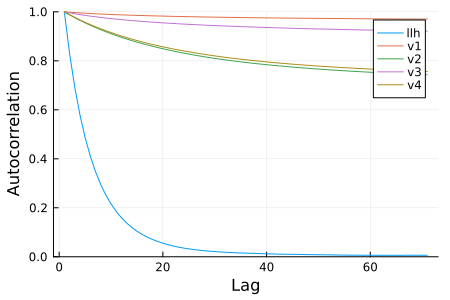

In [10]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

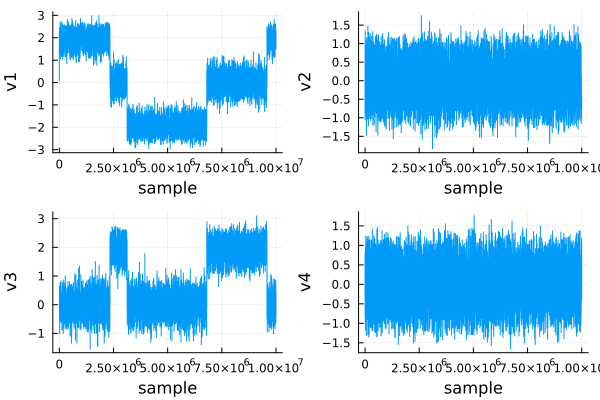

In [11]:
nthin=1000; idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

In [12]:
# idx = 6950000:7000000;
# gr(); 
# p = plot(layout=(4),xlab="sample",legend=false); 
# for i=1:4
#     plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
# end
# display(p)

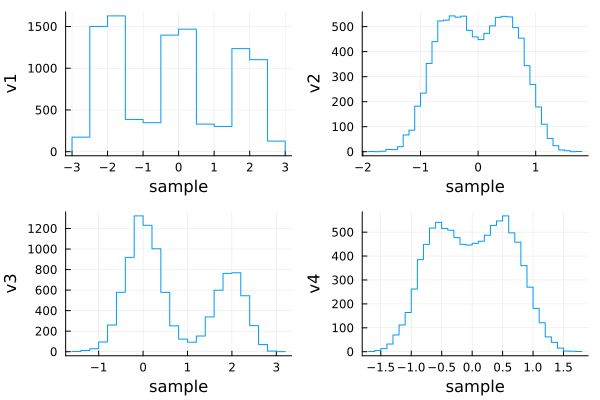

In [13]:
nthin=1000;
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)"); 
end
display(p)

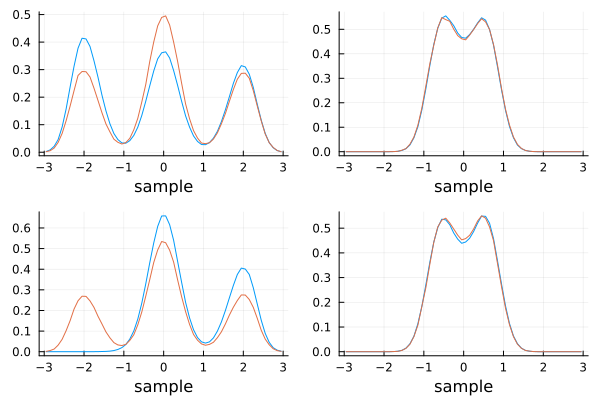

In [14]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights);
    plot!(p[i],midpts,h2.weights);
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

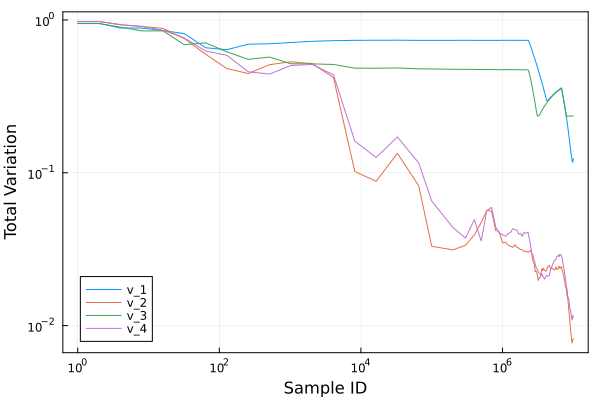

In [15]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

## Data Driven: HMC Chain 2 ##

In [16]:
file = "/projects/SIAllocation/lolmcNN/lolmcNN_055.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));

Read 10000000 samples from /projects/SIAllocation/lolmcNN/lolmcNN_055.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: hmc|0.25|2


In [17]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.3795       208.965200       103.767039       312.732239
    500001 -   1000000:   0.3803       213.277054        92.554734       305.831788
   1000001 -   1500000:   0.3821       197.800235       100.571888       298.372123
   1500001 -   2000000:   0.3785       212.167057        93.462131       305.629188
   2000001 -   2500000:   0.3760       214.921927        79.794953       294.716879
   2500001 -   3000000:   0.3782       161.072351       101.721408       262.793759
   3000001 -   3500000:   0.3804       217.568594        96.571979       314.140573
   3500001 -   4000000:   0.3814       199.099357        99.594471       298.693829
   4000001 -   4500000:   0.3778       176.449536        97.395564       273.845100
   4500001 -   5000000:   0.3768       199.218254       105.143775       304.362028
   5000001 -   5500000:   0.3773       186.450753        96

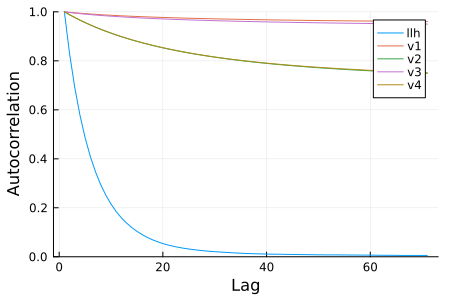

In [18]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

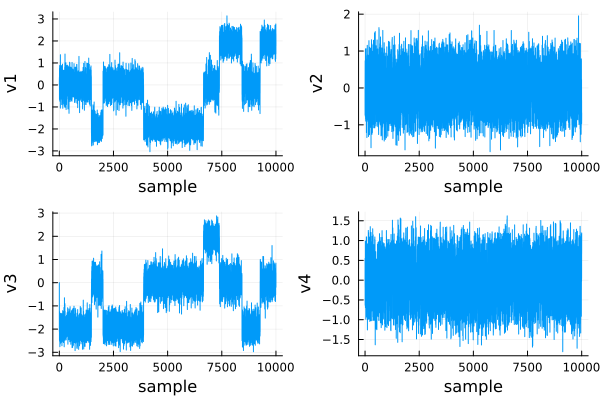

In [19]:
nthin=1000;
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],samples[1:nthin:end,i],ylab="v$(i)"); 
end
display(p)

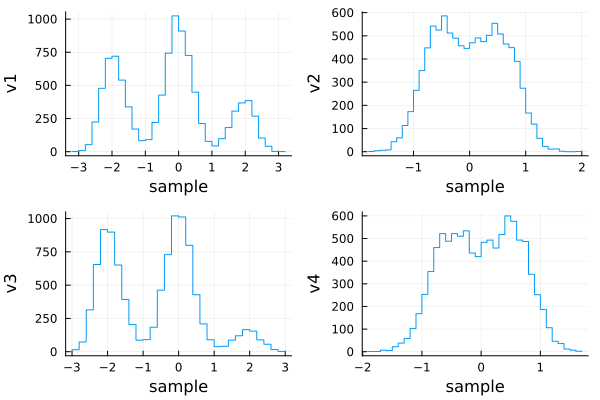

In [20]:
nthin=1000;
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)"); 
end
display(p)

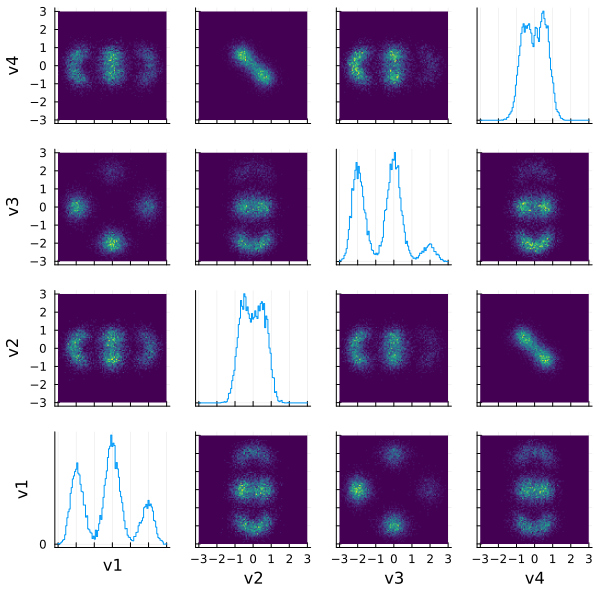

In [21]:
nthin=1000;
# adPlotHistMatrix(samples[1:nthin:end,1:4],"hist2d_lolmc";nbins=100,rng=[-3 3],comp=1:4,size=(800,800),
#     margin=0.0mm,xticks=-3:3,yticks=-3:3, label=["v$(i)" for i=1:4]);
bins=[ range(-3,stop=3,length=100) range(-3,stop=3,length=100) ];
histmatrix(samples[1:nthin:end,1:4];bins=bins,size=(600,600),
    margin=0.0mm,xticks=-3:3,yticks=-3:3, label=["v$(i)" for i=1:4])

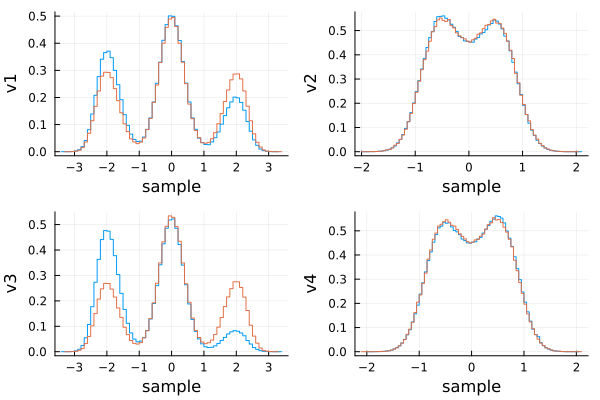

In [22]:
nthin=10;
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
    stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf); 
end
display(p)

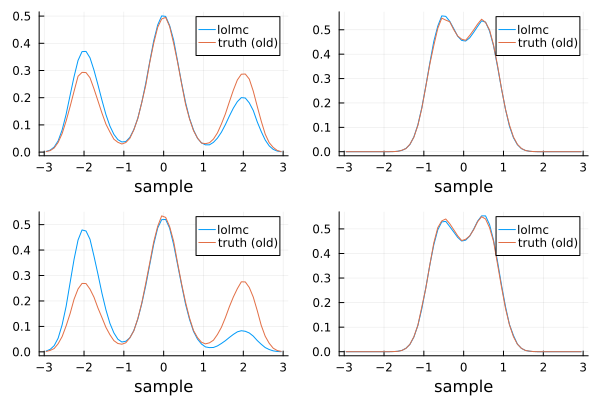

In [23]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

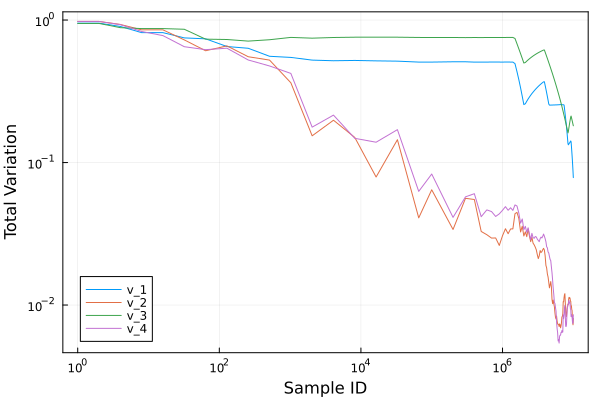

In [24]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

## Data Driven: MALA Chain 1 ##

In [25]:
file = "/projects/SIAllocation/lolmcNN/lolmcNN_054.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));

Read 10000000 samples from /projects/SIAllocation/lolmcNN/lolmcNN_054.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: mala|0.25


In [26]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.3851       195.551258       101.364444       296.915702
    500001 -   1000000:   0.3855       208.260045        94.283847       302.543892
   1000001 -   1500000:   0.3830       193.194061       104.565031       297.759092
   1500001 -   2000000:   0.3877       194.938596       100.731921       295.670517
   2000001 -   2500000:   0.3856       216.174694       101.050472       317.225166
   2500001 -   3000000:   0.3877       201.631050        97.701488       299.332538
   3000001 -   3500000:   0.3862       185.383074       106.093690       291.476764
   3500001 -   4000000:   0.3851       207.886395       101.952815       309.839210
   4000001 -   4500000:   0.3874       191.193114        92.404058       283.597172
   4500001 -   5000000:   0.3898       197.475920        94.889914       292.365833
   5000001 -   5500000:   0.3871       211.518589        89

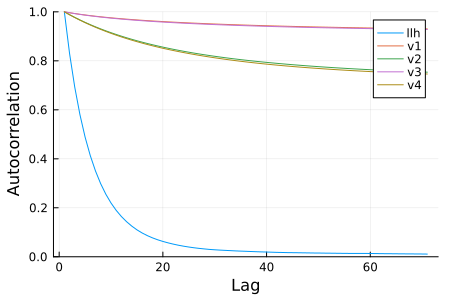

In [27]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

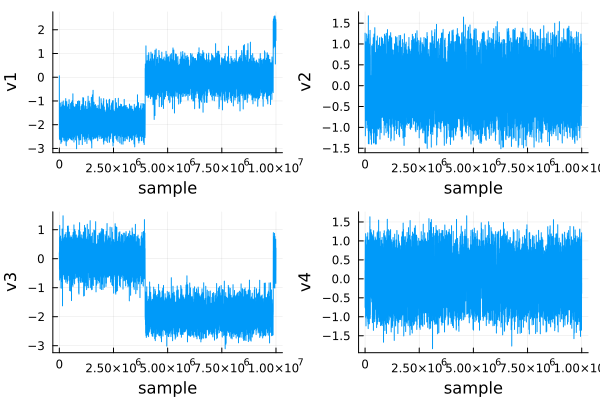

In [28]:
nthin=1000;
idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

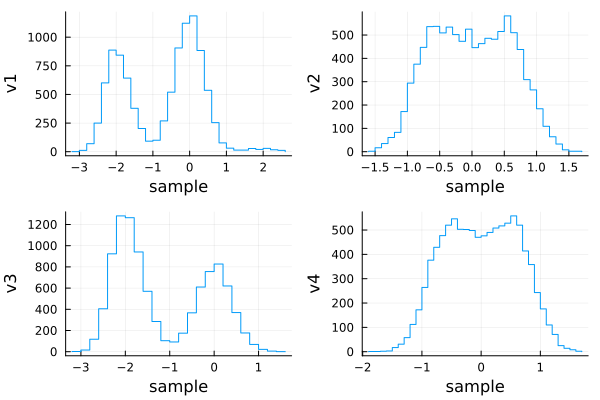

In [29]:
nthin=1000;
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)"); 
end
display(p)

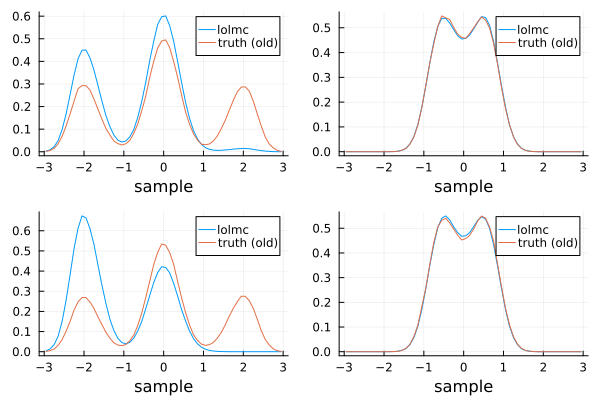

In [30]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

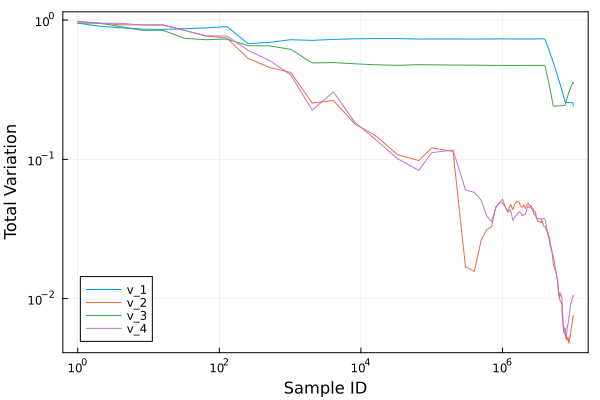

In [31]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

## Data Driven: MALA Chain 2 ##

In [32]:
file = "/projects/SIAllocation/lolmcNN/lolmcNN_056.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));

Read 10000000 samples from /projects/SIAllocation/lolmcNN/lolmcNN_056.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: mala|0.25


In [33]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.3850       192.324982        96.661543       288.986524
    500001 -   1000000:   0.3859       189.706172        97.138248       286.844420
   1000001 -   1500000:   0.3848       205.248920       101.168514       306.417434
   1500001 -   2000000:   0.3844       211.483056        90.984291       302.467348
   2000001 -   2500000:   0.3844       206.936310        95.183494       302.119804
   2500001 -   3000000:   0.3827       183.195620       106.689048       289.884668
   3000001 -   3500000:   0.3829       182.602699       104.318172       286.920871
   3500001 -   4000000:   0.3851       181.126428       101.745876       282.872304
   4000001 -   4500000:   0.3838       201.824548        99.470117       301.294665
   4500001 -   5000000:   0.3850       191.354155        97.592614       288.946768
   5000001 -   5500000:   0.3844       181.748174       108

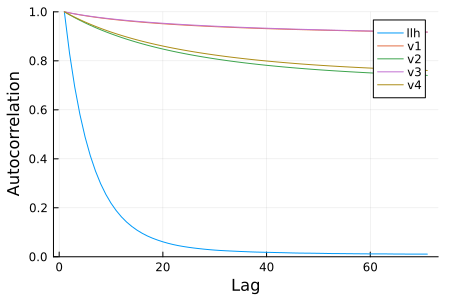

In [34]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

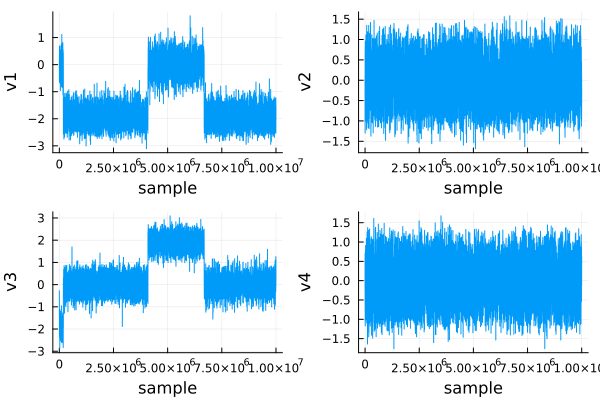

In [35]:
nthin=1000;
idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

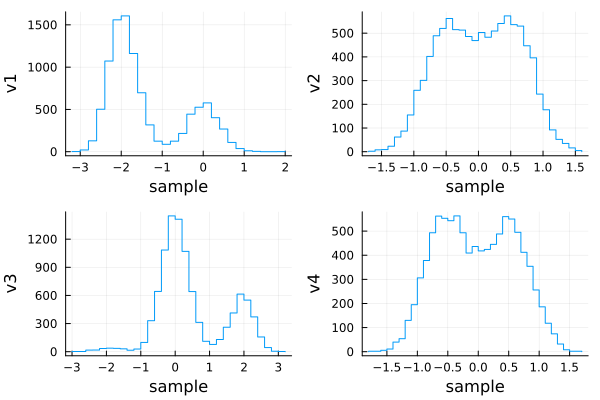

In [36]:
nthin=1000;
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)"); 
end
display(p)

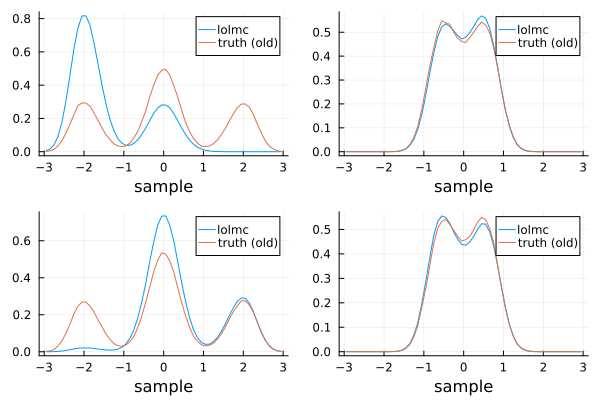

In [37]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

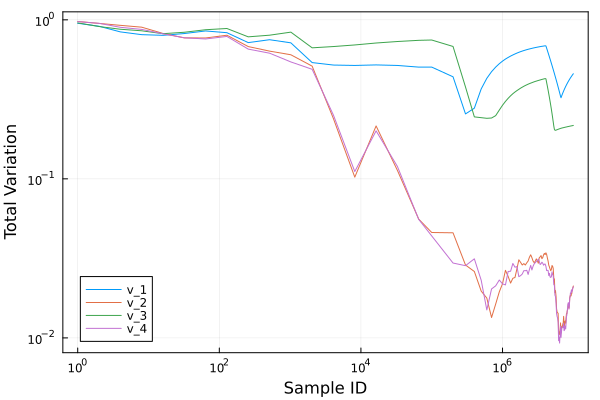

In [38]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

# Galerkin Truncation of gradPhi #

## Galerkin: HMC Chain 1 ##

In [39]:
file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));
f = h5open(file);
if haskey(f,"maxnormGalerkin")
    gnorm = read(f,"maxnormGalerkin");
else
    gnorm = 4;
end
close(f);
println("Galerkin norm is: $(gnorm)")

Read 12000000 samples from /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5
Done. 12000000 total samples read out of 12000000 found.
MCMC method is: lolhmc|2^-4|2
Galerkin norm is: 4


In [40]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    600000:   0.4479       183.420352       105.650349       289.070701
    600001 -   1200000:   0.4488       195.738493        97.343326       293.081820
   1200001 -   1800000:   0.4498       190.010595       106.790346       296.800941
   1800001 -   2400000:   0.4402       195.671159       101.251373       296.922532
   2400001 -   3000000:   0.4499       193.909081       100.908911       294.817992
   3000001 -   3600000:   0.4413       188.367721       103.204973       291.572693
   3600001 -   4200000:   0.4514       208.040655        96.937691       304.978346
   4200001 -   4800000:   0.4458       217.009280        94.729500       311.738780
   4800001 -   5400000:   0.4431       206.802858        95.157263       301.960120
   5400001 -   6000000:   0.4477       186.372828       104.493528       290.866355
   6000001 -   6600000:   0.4484       195.761321       100

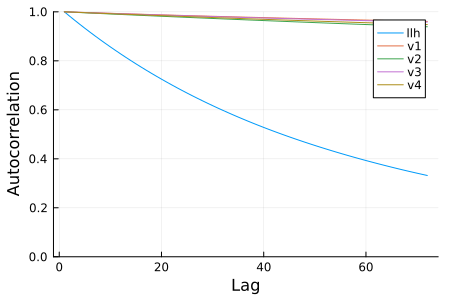

In [41]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

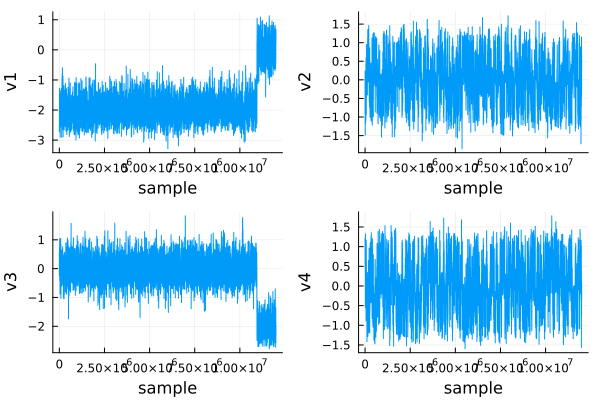

In [42]:
nthin=1000;
idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

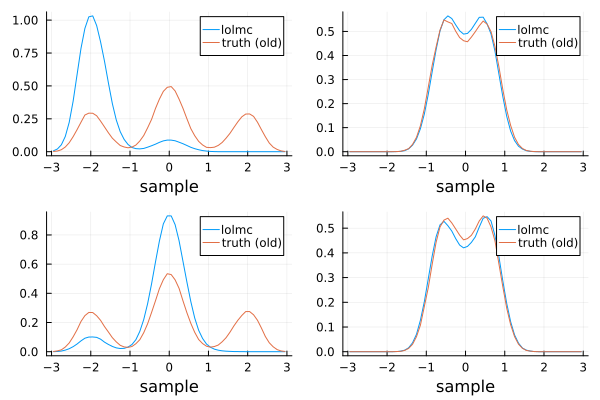

In [43]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

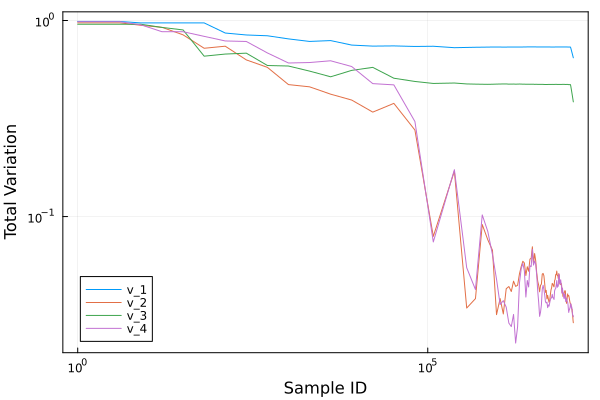

In [44]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

## Galerkin: HMC Chain 2 ##

In [45]:
# file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_009.h5";
file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));
f = h5open(file);
if haskey(f,"maxnormGalerkin")
    gnorm = read(f,"maxnormGalerkin");
else
    gnorm = 4;
end
close(f);
println("Galerkin norm is: $(gnorm)");

Read 10000000 samples from /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: lolhmc|2^-2|2
Galerkin norm is: 6


In [46]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.1659       192.794278        95.853082       288.647361
    500001 -   1000000:   0.1677       207.179006       100.505296       307.684302
   1000001 -   1500000:   0.1645       204.107779       101.733193       305.840972
   1500001 -   2000000:   0.1707       201.135043        95.459090       296.594133
   2000001 -   2500000:   0.1729       200.102268       101.180411       301.282679
   2500001 -   3000000:   0.1675       186.630083       106.546206       293.176289
   3000001 -   3500000:   0.1685       200.814034       101.789303       302.603337
   3500001 -   4000000:   0.1779       193.718742        96.094244       289.812986
   4000001 -   4500000:   0.1716       185.209803       102.391686       287.601489
   4500001 -   5000000:   0.1810       194.320992        93.233145       287.554137
   5000001 -   5500000:   0.1756       191.648168        98

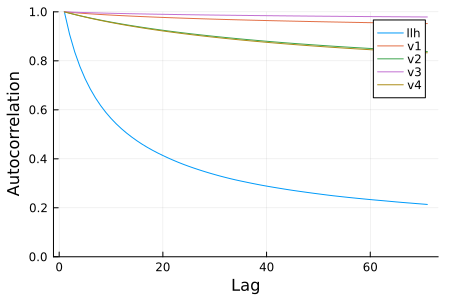

In [47]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

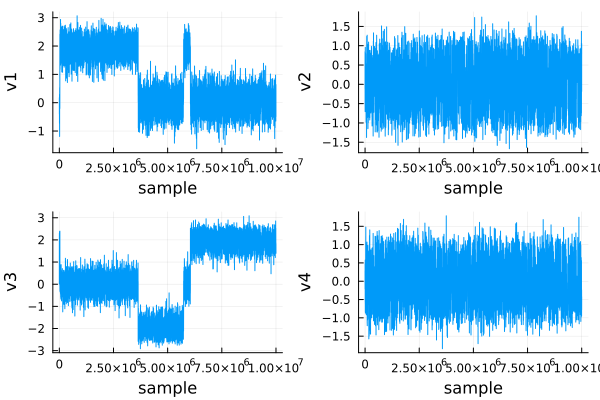

In [48]:
nthin=1000;
idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

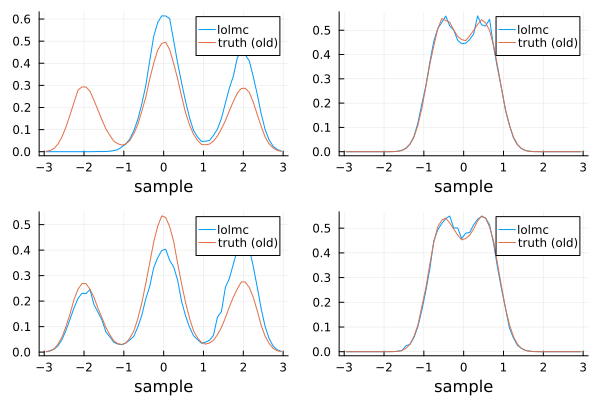

In [49]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

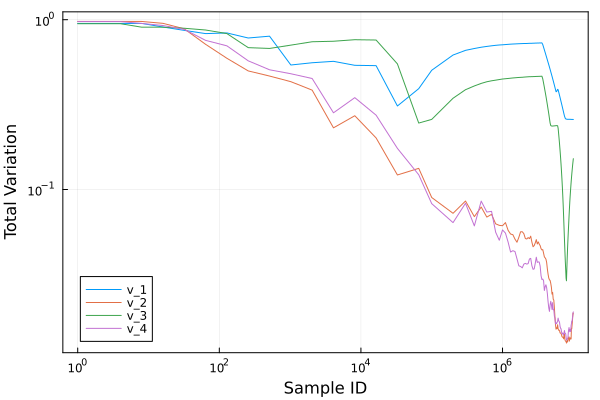

In [50]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

## Galerkin: MALA Chain 1 ##

In [51]:
# file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_010.h5";
file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));
f = h5open(file);
if haskey(f,"maxnormGalerkin")
    gnorm = read(f,"maxnormGalerkin");
else
    gnorm = 4;
end
close(f);
println("Galerkin norm is: $(gnorm)");

Read 10000000 samples from /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: mala|2^-3
Galerkin norm is: 4


In [52]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.0603       190.409317        95.483357       285.892674
    500001 -   1000000:   0.0553       211.288837       100.378252       311.667089
   1000001 -   1500000:   0.0688       192.053776       102.070259       294.124035
   1500001 -   2000000:   0.0546       206.349214        97.468365       303.817579
   2000001 -   2500000:   0.0556       210.604982       104.705721       315.310703
   2500001 -   3000000:   0.0616       201.429883        99.645920       301.075804
   3000001 -   3500000:   0.0591       188.148579        97.550566       285.699144
   3500001 -   4000000:   0.0573       217.014564        95.352151       312.366715
   4000001 -   4500000:   0.0594       171.731983        87.818457       259.550440
   4500001 -   5000000:   0.0620       168.724742       105.771327       274.496069
   5000001 -   5500000:   0.0604       194.675263       108

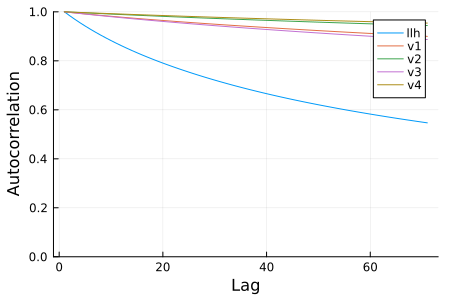

In [53]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

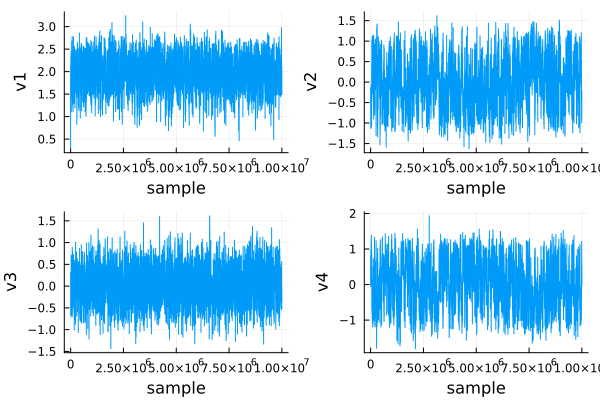

In [54]:
nthin=1000;
idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

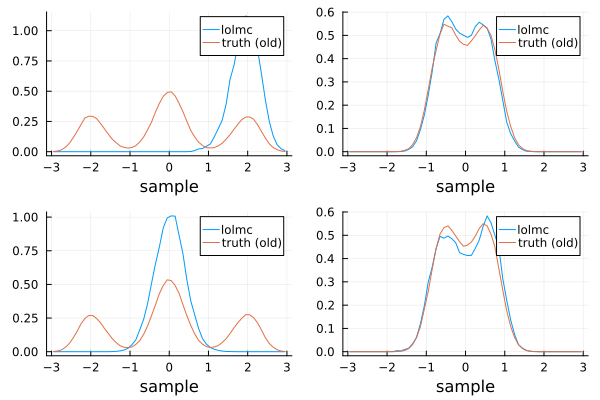

In [55]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

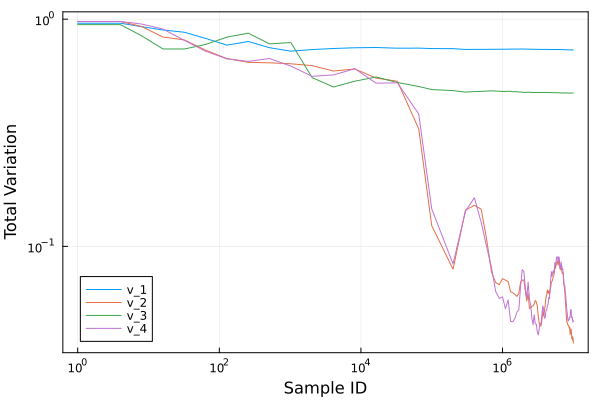

In [56]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

## Galerkin: MALA Chain 2 ##

In [57]:
# file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_008.h5";
file = "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052.h5";
samples, _, lpdfs, ar, files = assembleChain(file;verbose=true,sampleThin=sthin,sampleCols=1:8,obsCols=1:2);
@printf("MCMC method is: %s\n",h5read(file,"mcmc"));
f = h5open(file);
if haskey(f,"maxnormGalerkin")
    gnorm = read(f,"maxnormGalerkin");
else
    gnorm = 4;
end
close(f);
println("Galerkin norm is: $(gnorm)");

Read 10000000 samples from /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052.h5
Done. 10000000 total samples read out of 10000000 found.
MCMC method is: mala|2^-2
Galerkin norm is: 6


In [58]:
stp=max(1,round(Int,length(ar)/20));
@printf("\nSummary of run:\n");
@printf("%10s  %10s: %8s ", "start", "end", "ar (avg)"); 
@printf("%16s %16s %16s\n", "logprior", "loglikelihood", "logposterior");
for i=0:stp:length(ar)-1
  @printf("%10d -%10d:",i+1,i+stp);
  @printf(" %8.4f",mean( ar[i+1:i+stp] )); 
  @printf(" %16.6f %16.6f %16.6f\n", lpdfs[i+stp,1], lpdfs[i+stp,2], lpdfs[i+stp,3]);
end


Summary of run:
     start         end: ar (avg)         logprior    loglikelihood     logposterior
         1 -    500000:   0.1926       199.952235        93.032153       292.984389
    500001 -   1000000:   0.1950       197.227675        91.156011       288.383687
   1000001 -   1500000:   0.1966       201.594889        95.967961       297.562850
   1500001 -   2000000:   0.1931       211.111053       100.981907       312.092960
   2000001 -   2500000:   0.1939       207.330993       103.534782       310.865775
   2500001 -   3000000:   0.1955       188.763517       104.130734       292.894251
   3000001 -   3500000:   0.1970       185.998926       100.840991       286.839917
   3500001 -   4000000:   0.1830       185.803688        98.123434       283.927123
   4000001 -   4500000:   0.1744       200.961411       105.760609       306.722021
   4500001 -   5000000:   0.1911       199.772710        92.044963       291.817672
   5000001 -   5500000:   0.1896       191.596474        98

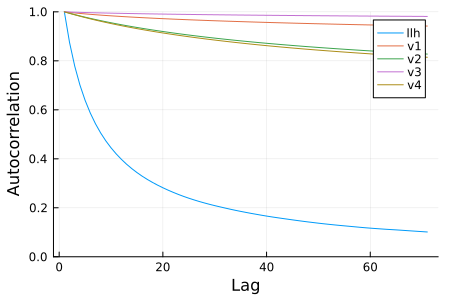

In [59]:
llhAC = autocor(lpdfs[:,2]);
vACidx = 1:4; vAC = [ autocor(samples[:,i]) for i=vACidx ];
gr();
p = plot(ylim=(0,1), xlab = "Lag", ylab = "Autocorrelation",size=(450,300))
plot!(p,llhAC,lab="llh")
for i=1:length(vAC); plot!(p,vAC[i],lab="v$(vACidx[i])"); end
display(p)

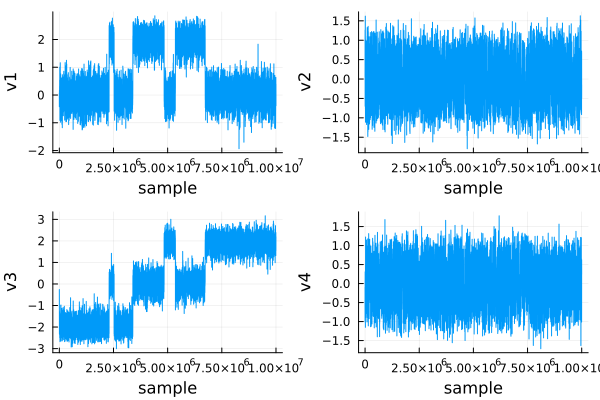

In [60]:
nthin=1000;
idx=1:nthin:size(samples,1);
gr(); 
p = plot(layout=(4),xlab="sample",legend=false); 
for i=1:4
    plot!(p[i],idx,samples[idx,i],ylab="v$(i)"); 
end
display(p)

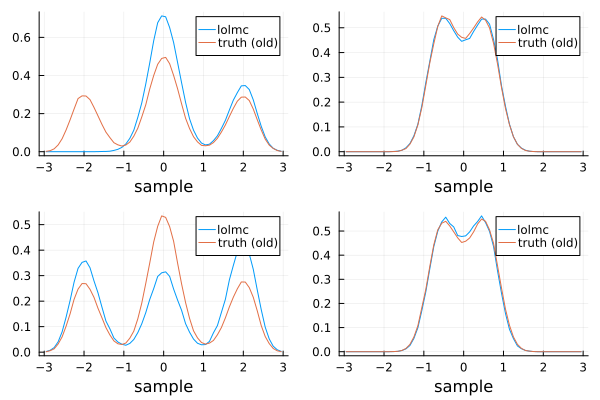

In [61]:
nthin=1;
bins=-3:0.1:3;
midpts = 0.5*( bins[2:end] + bins[1:end-1] );
gr(); 
p = plot(layout=(4),xlab="sample",legend=:topright); 
for i=1:4
#     stephist!(p[i],samples[1:nthin:end,i],ylab="v$(i)",bins=100,normalize=:pdf); 
#     stephist!(p[i],samplesTrue[:,i],ylab="v$(i)",bins=100,normalize=:pdf);
    h1 = fit(Histogram, samples[1:nthin:end,i], bins);
    h1 = normalize(h1, mode=:pdf);
    h2 = fit(Histogram, samplesTrue[:,i], bins);
    h2 = normalize(h2, mode=:pdf);
    plot!(p[i],midpts,h1.weights,lab="lolmc");
    plot!(p[i],midpts,h2.weights,lab="truth (old)");
#     @printf("TV %d: %10.6f\n",i,0.5*dot(bins[2:end] - bins[1:end-1],abs.(h2.weights-h1.weights)))
end
display(p)

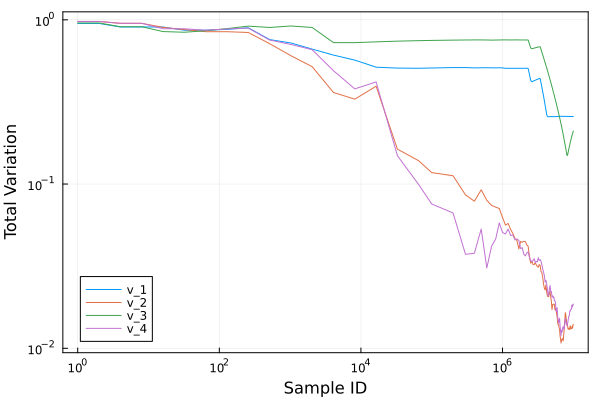

In [62]:
tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
if !isfile(tvFile)
    adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
end
adPlotTotVarEvolve(tvFile)

# Comparison #

In [63]:
# files = [
#     "/groups/SIAllocation/runs/154835/adr_bayes.h5";
#     "/groups/SIAllocation/runs/173291/adr_bayes.h5";
#     "/groups/SIAllocation/lolmc/lolmc_001.h5";
#     "/groups/SIAllocation/lolmc/lolmc_003.h5";
#     "/groups/SIAllocation/lolmc/lolmc_002.h5";
#     "/groups/SIAllocation/lolmc/lolmc_004.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_009.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_006.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_008.h5"
# ];

# # baselinefiles = [
# #     "/groups/SIAllocation/2020juqex2/2020juqex2_001.h5";
# #     "/groups/SIAllocation/2020juqex2/2020juqex2_002.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_037.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_038.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_039.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_040.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_010.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_011.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_012.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_013.h5"
# #     ];
# # baselinefiles = [
# #     "/groups/SIAllocation/2020juqex2/2020juqex2_001.h5";
# #     "/groups/SIAllocation/2020juqex2/2020juqex2_003.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_041.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_041.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_039.h5";
# #     "/groups/SIAllocation/lolmc/lolmc_040.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_010.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_011.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_012.h5";
# #     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_013.h5"
# #     ];
# baselinefiles = [
#     "/groups/SIAllocation/2020juqex2/2020juqex2_001.h5";
#     "/groups/SIAllocation/2020juqex2/2020juqex2_003.h5";
#     "/groups/SIAllocation/lolmc/lolmc_001.h5";
#     "/groups/SIAllocation/lolmc/lolmc_003.h5";
#     "/groups/SIAllocation/lolmc/old_prior/lolmc_044.h5";
#     "/groups/SIAllocation/lolmc/old_prior/lolmc_045.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_001.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_003.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_002.h5";
#     "/groups/SIAllocation/lolmcGalerkin/lolmcGalerkin_004.h5"
#     ];


# labels = [
#     "HMC";
#     "pCN";
#     "K-L HMC 1";
#     "K-L HMC 2";
#     "K-L MALA 1";
#     "K-L MALA 2";
#     "Galerkin HMC 1";
#     "Galerkin HMC 2";
#     "Galerkin MALA 1";
#     "Galerkin MALA 2"
# ];

# linestyles = [
#     :solid;
#     :dash;
#     :solid;
#     :solid;
#     :dash;
#     :dash;
#     :solid;
#     :solid;
#     :dash;
#     :dash;
# ];

# linecolors = [ :black :black 1 1 1 1 2 2 2 2 ];#ceil.(Int,(1:length(files))/2);

In [11]:
# files = [
#     "/projects/SIAllocation/runs/154835/adr_bayes.h5";
#     "/projects/SIAllocation/runs/173291/adr_bayes.h5";
#     "/projects/SIAllocation/lolmcNN/lolmcNN_053.h5";
# #     "/projects/SIAllocation/lolmcNN/lolmcNN_051.h5";
#     "/projects/SIAllocation/lolmcNN/lolmcNN_054.h5";
# #     "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
#     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5";
# #     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_009.h5";
#     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_010.h5";
# #     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_008.h5"
# ];


# baselinefiles = [
#     "/projects/SIAllocation/2020juqex2/2020juqex2_010.h5";
#     "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
#     "/projects/SIAllocation/lolmcNN/lolmcNN_049.h5";
# #     "/projects/SIAllocation/lolmcNN/lolmcNN_051.h5";
#     "/projects/SIAllocation/lolmcNN/lolmcNN_050.h5";
# #     "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
#     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_011.h5";
# #     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_009.h5";
#     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_012.h5";
# #     "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_008.h5"
#     ];

files = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_050.h5";
    "/projects/SIAllocation/runs/173291/adr_bayes.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_054.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052.h5";
];

baselinefiles = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_055.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_050.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_053.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_055.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_054.h5";
    "/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_056.h5";
    ];


labels = [
    "HMC";
    "pCN";
    "Data Driven HMC";
    "Data Driven MALA";
    "Galerkin HMC (4)";
    "Galerkin MALA (4)";
    "Galerkin HMC (6)";
    "Galerkin MALA (6)";
];

linestyles = [
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
    :dash;
];

linecolors = [ :black :black 1 1 2 2 3 3 ];#ceil.(Int,(1:length(files))/2);

In [8]:
#experimenting with different NN architectures
files = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_050.h5";
    "/projects/SIAllocation/runs/173291/adr_bayes.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_064.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_070.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_065.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_069.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_071.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_054.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_072.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_066.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_073.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_067.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_099.h5";
];

baselinefiles = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_055.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_070.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_066.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_067.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
];


labels = [
    "HMC";
    "pCN";
    "NNgHMC (S)";
    "NNgMALA (S)";
    "NNgHMC (M)";
    "NNgMALA (M)";
    "NNgHMC (L)";
    "NNgMALA (L)";
    "mpCN";
];

linestyles = [
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
];

linecolors = [ :black :black 2 2 1 1 3 3 4 ];#ceil.(Int,(1:length(files))/2);

In [34]:
#experimenting with different NN architectures, plus mpCN
files = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_050.h5";
    "/projects/SIAllocation/runs/173291/adr_bayes.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_064.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_070.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_065.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_069.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_071.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_054.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_072.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_066.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_074.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_067.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_099.h5";
];

baselinefiles = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_055.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_070.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_066.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_074.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
];


labels = [
    "HMC";
    "pCN";
    "NNgHMC (S)";
    "NNgMALA (S)";
    "NNgHMC (M)";
    "NNgMALA (M)";
    "NNgHMC (L)";
    "NNgMALA (L)";
    "mpCN";
];

linestyles = [
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
    :dash;
    :solid;
];

linecolors = [ :black :black 2 2 1 1 3 3 4 ];#ceil.(Int,(1:length(files))/2);

plotDataFile = "plotData_15M_nn_mppcn3.h5";

In [8]:
#simpler: one NN, plus mpCN
files = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_050.h5";
    "/projects/SIAllocation/runs/173291/adr_bayes.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_064.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_070.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_065.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_069.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_071.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_054.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_072.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_066.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_074.h5"; #"/projects/SIAllocation/lolmcNN/lolmcNN_067.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_099.h5";
];

baselinefiles = [
    "/projects/SIAllocation/2020juqex2/2020juqex2_055.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_070.h5";
    "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_059.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_052.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_066.h5";
    # "/projects/SIAllocation/lolmcNN/lolmcNN_074.h5";
    "/projects/SIAllocation/2020juqex2/2020juqex2_011.h5";
];


labels = [
    "HMC";
    "pCN";
    "NNgHMC"; #"NNgHMC (S)";
    "NNgMALA"; #"NNgMALA (S)";
    # "NNgHMC (M)";
    # "NNgMALA (M)";
    # "NNgHMC (L)";
    # "NNgMALA (L)";
    "mpCN";
];

linestyles = [
    :solid;
    :dash;
    :solid;
    :dash;
    # :solid;
    # :dash;
    # :solid;
    # :dash;
    :solid;
];

# linecolors = [ :black :black 2 2 1 1 3 3 4 ];#ceil.(Int,(1:length(files))/2);
linecolors = [ :black :black 1 1 2 ];

plotDir = "simple";
plotDataFile = "plotData_15M_simple.h5";

In [9]:
for i=1:length(files)
    file = files[i];
    baselinefile = baselinefiles[i];
    label = labels[i];
    f = h5open(baselinefile);
    sampPerSec = read(f,"sampPerSec");
    mcmcBase   = read(f,"mcmc");
    if haskey(f,"maxnormGalerkin")
        gnormBase = read(f,"maxnormGalerkin");
    else
        gnormBase = 0;
    end
    close(f);
    f = h5open(file);
    if haskey(f,"mcmc")
        mcmc = h5read(file,"mcmc");
    else
        if haskey(f,"hmc_e")
            hmc_e   = read(f,"hmc_e");
            hmc_tau = read(f,"hmc_tau");
            hmc_I   = round(Int,hmc_tau/hmc_e);
            mcmc = "hmc|$(hmc_e)|$(hmc_I)";
        elseif haskey(f,"pcn_beta")
            mcmc = "pcn|$(read(f,"pcn_beta"))";
        else
            println("unknown mcmc method: $file");
        end
    end
    if haskey(f,"maxnormGalerkin")
        gnorm = read(f,"maxnormGalerkin");
    else
        gnorm = 0;
    end
    close(f);
#     println("$(label) ($(file)): $(sampPerSec)");
    @printf("%20s (%20s, %15s, %4d): %8.4f (%20s, %15s, %4d)\n",label,basename(file),mcmc,gnorm,sampPerSec,basename(baselinefile),mcmcBase,gnormBase);
end

                 HMC (   2020juqex2_050.h5,      hmc|2^-2|4,    0):  30.7026 (   2020juqex2_055.h5,      hmc|2^-2|4,    0)
                 pCN (        adr_bayes.h5,         pcn|0.2,    0): 567.3751 (   2020juqex2_011.h5,         pcn|0.2,    0)
              NNgHMC (      lolmcNN_064.h5,   lolhmc|0.25|2,    0): 416.2489 (      lolmcNN_070.h5,   lolhmc|0.25|2,    0)
             NNgMALA (      lolmcNN_065.h5,       mala|0.25,    0): 504.9232 (      lolmcNN_052.h5,       mala|0.25,    0)
                mpCN (   2020juqex2_099.h5,   mppcn|0.25|64,    0): 567.3751 (   2020juqex2_011.h5,         pcn|0.2,    0)


In [10]:
function getNsamp(file)
    nsamp = 0;
    firstfile = false;
    while !firstfile
#         @printf("Reading from %25s: ",file);
        f = h5open(file);
        nsamp += read(f,"nsamp");
#        if any(x->x=="restartfile", names(f))
        if haskey(f,"restartfile")
            file = read(f,"restartfile");
        else
            firstfile = true;
        end
        close(f);
#         @printf("nsamp = %d\n",nsamp);
    end
    
    return nsamp;
end
nsamps = [ getNsamp(file) for file in files ]

5-element Vector{Int64}:
   500000
 20000000
 10000000
 10000000
   250000

In [11]:
baselineSampPerSec = h5read(baselinefiles[1],"sampPerSec");
for i=1:length(files)
    file = files[i];
    baselinefile = baselinefiles[i];
    label = labels[i];
    sampPerSec = h5read(baselinefile,"sampPerSec");
    sampPerBaselineSamp = sampPerSec/baselineSampPerSec;
    sampComplete = nsamps[i];
    effSamples = sampComplete / sampPerBaselineSamp;
    mcmc = try 
        h5read(file,"mcmc")
    catch e
        h5read(baselinefile,"mcmc")
    end
    mcmcs = split(mcmc,"|");
    mcmcmeth = uppercase(mcmcs[1]);
    
    if mcmcmeth=="HMC" || mcmcmeth=="LOLHMC"
        mcmcp = "("*mcmcs[2]*", "*mcmcs[3]*")";
    else
        mcmcp = "("*mcmcs[2]*")";
    end
        
#     println("$(label) ($(file)): $(sampPerSec)");
    @printf("%20s | %8s | %10s | %10d | %6.1f | %8.1f \n",label,mcmcmeth,mcmcp,sampComplete,sampPerBaselineSamp,effSamples);
end

                 HMC |      HMC |  (2^-2, 4) |     500000 |    1.0 | 500000.0 
                 pCN |      PCN |      (0.2) |   20000000 |   18.5 | 1082269.8 
              NNgHMC |   LOLHMC |  (0.25, 2) |   10000000 |   13.6 | 737603.0 
             NNgMALA |     MALA |     (0.25) |   10000000 |   16.4 | 608065.6 
                mpCN |    MPPCN |     (0.25) |     250000 |   18.5 |  13528.4 


In [12]:
for i=1:length(files)
    file = files[i];
    try
        mcmcTime = h5read(file,"mcmcTime");
        println("$(file): $(mcmcTime)");
    catch e
        mcmcTime = h5read(replace(file,".h5"=>"_orig.h5"),"mcmcTime");
        println("$(file): $(mcmcTime)");
    end
    #@printf("%20s | %8s | %10s | %10d | %6.1f | %8.1f \n",label,mcmcmeth,mcmcp,sampComplete,sampPerBaselineSamp,effSamples);
end

/projects/SIAllocation/2020juqex2/2020juqex2_050.h5: 19484.762002062
/projects/SIAllocation/runs/173291/adr_bayes.h5: 476028
/projects/SIAllocation/lolmcNN/lolmcNN_064.h5: 25909.23313084
/projects/SIAllocation/lolmcNN/lolmcNN_065.h5: 21669.230092525
/projects/SIAllocation/2020juqex2/2020juqex2_099.h5: 69415.94775582


In [13]:
function getAcceptRate(file)
    nsamp = 0;
    naccept = 0;
    firstfile = false;
    while !firstfile
#         @printf("Reading from %40s: ",file);
        f = h5open(file);
        nsamp   += read(f,"nsamp");
        naccept += sum(read(f,"ar"));
        if haskey(f,"restartfile")
            file = read(f,"restartfile");
        else
            firstfile = true;
        end
        close(f);
#         @printf("nsamp = %10d, naccept = %10d\n",nsamp,naccept);
    end
    ar = naccept / nsamp;
    
    return ar;
end
ars = [ getAcceptRate(file) for file in files ]

5-element Vector{Float64}:
 0.96119
 0.27056525
 0.4056976
 0.4075024
 0.478744

In [14]:
baselineSampPerSec = h5read(baselinefiles[1],"sampPerSec");
sampFactors = [ baselineSampPerSec / h5read(baselinefile,"sampPerSec") for baselinefile in baselinefiles ];
sampFactors

5-element Vector{Float64}:
 1.0
 0.054113489355221096
 0.0737603024911833
 0.060806558197773516
 0.054113489355221096

In [15]:
function h5WriteArrayOfArrays(outFile,dataName,array)
    for i=1:length(array)
        h5write(outFile,"$(dataName)/$(i)",array[i]);
    end
end;

In [16]:
function h5ReadArrayOfArrays(inFile,dataName)
    f = h5open(inFile,"r");
    dset = f[dataName];
    array = [ read(dset,"$(i)") for i=1:length(dset) ];
    close(f);
    return array;
end;

## Total Variation ##

In [19]:
# compList=1:4 #hopefully this matches input files
# # p = plot(layout=(length(compList)))
# p1 = plot(size=(1200,1200), layout = @layout([[A B; C D]; E{0.25h}]));
# p2 = plot(size=(1200,1200), layout = @layout([[A B; C D]; E{0.25h}]));

# hmcSampPerSec = h5read(baselinefiles[1],"sampPerSec");

# #loop over files
# for i = 1:length(files)
#     file   = files[i];
#     label  = labels[i];
#     baselinefile   = baselinefiles[i];
    
#     sampPerSec = h5read(baselinefile,"sampPerSec");
#     sampFactor = hmcSampPerSec / sampPerSec;
    
#     #read data
#     tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
#     if !isfile(tvFile)
#         tvFile = replace(file,"adr_bayes.h5"=>"obs/totVar_evolve.h5");
#     end
#     println(tvFile);
#     tv       = h5read(tvFile,"tv");
#     #compList = h5read(tvFile,"compList");
#     idxList  = h5read(tvFile,"idxList");
    
#     #plot
#     for j=1:length(compList)
#         comp=compList[j]; #component to look at
#         plot!(p1[j],idxList,tv[:,j],ls=linestyles[i],color=linecolors[i]);#, lab=label);
#         plot!(p2[j],idxList.*sampFactor,tv[:,j],ls=linestyles[i],color=linecolors[i]);#, lab=label);
#     end 
# end

# #label, etc
# for j=1:length(compList)
#     comp=compList[j];
#     plot!(p1[j],xlab = "Sample ID", ylab = "Tot Var (v_$comp)",framestyle=:box,xscale=:log10,yscale=:log10,leg=:none);#bottomleft);#,xlim=:none,ylim=(1e-2,1));
#     #plot!(p1[j],tickfontsize=16,legendfontsize=16,guidefontsize=18); #professional options for when figure size is larger
#     plot!(p2[j],xlab = "Sample ID", ylab = "Tot Var (v_$comp)",framestyle=:box,xscale=:log10,yscale=:log10,leg=:none);#bottomleft);#,xlim=:none,ylim=(1e-2,1));
#     #plot!(p2[j],tickfontsize=16,legendfontsize=16,guidefontsize=18); #professional options for when figure size is larger
# end

# #add legend in "5th" plot
# plot!(p1[end],zeros(1,length(files)), showaxis = false, grid = false, 
#     ls = reshape(linestyles,1,length(linestyles)), 
#     color = reshape(linecolors,1,length(linecolors)), 
#     label = reshape(labels,1,length(labels)),
#     leg = :topleft);
# plot!(p2[end],zeros(1,length(files)), showaxis = false, grid = false, 
#     ls = reshape(linestyles,1,length(linestyles)), 
#     color = reshape(linecolors,1,length(linecolors)), 
#     label = reshape(labels,1,length(labels)),
#     leg = :topleft);

# display(p1)
# savefig(p1,"tv_compare_by_sample.png");
# display(p2)
# savefig(p2,"tv_compare_by_comptime.png");

# for i=1:length(p1)-1
#     plot!(p1[i],xscale=:none);
#     plot!(p2[i],xscale=:none);
# end
# display(p1)
# savefig(p1,"tv_compare_by_sample_linear.png");
# display(p2)
# savefig(p2,"tv_compare_by_comptime_linear.png");

In [20]:
# file = files[1];
# tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
# if !isfile(tvFile)
#     f = h5open(file);
#     samples = f["samples"][:,1:4]; #h5read(files[1],"samples");
#     close(f);
#     adComputeTotVarEvolve( samples, samplesTrue; outFile=tvFile, comp=1:4, nsteps=nsteps);
# end
# adPlotTotVarEvolve(tvFile)

In [21]:
tvs = fill(Array{Float64}(undef, 0, 2),length(files));
idxLists = fill(Int64[],length(files));
for i = 1:length(files)
    file   = files[i];
    
    #read data
    tvFile = replace(file,".h5"=>"_totVarEvolve.h5");
    if !isfile(tvFile)
        tvFile = replace(file,"adr_bayes.h5"=>"obs/totVar_evolve.h5");
    end
    println(tvFile);
    tvs[i]       = h5read(tvFile,"tv");
    idxLists[i]  = h5read(tvFile,"idxList");
end

/projects/SIAllocation/2020juqex2/2020juqex2_050_totVarEvolve.h5
/projects/SIAllocation/runs/173291/obs/totVar_evolve.h5
/projects/SIAllocation/lolmcNN/lolmcNN_053_totVarEvolve.h5
/projects/SIAllocation/lolmcNN/lolmcNN_054_totVarEvolve.h5
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005_totVarEvolve.h5
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051_totVarEvolve.h5
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050_totVarEvolve.h5
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052_totVarEvolve.h5


In [22]:
try
    h5WriteArrayOfArrays(plotDataFile,"tvs",tvs);
    h5WriteArrayOfArrays(plotDataFile,"idxLists",idxLists);
catch e
    println("Dataset already appears to exist in $(plotDataFile). Skipping write.");
end

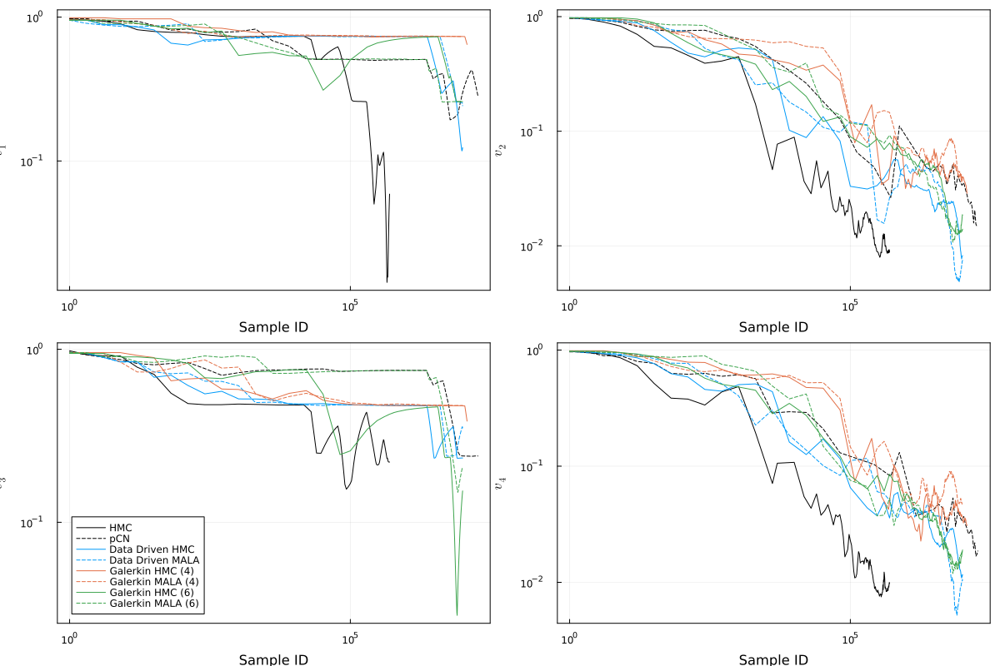

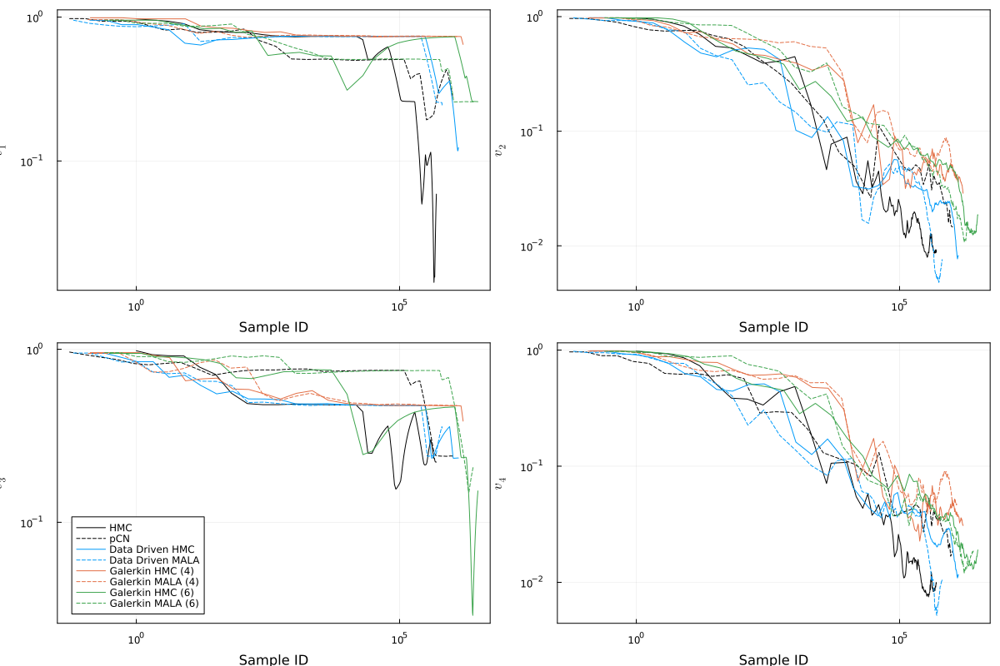

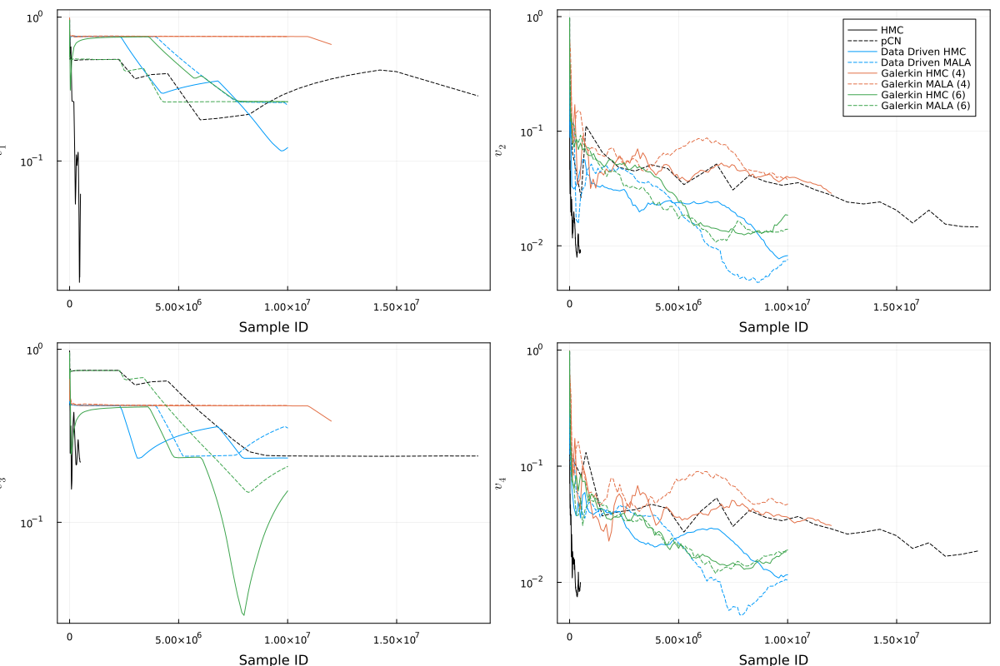

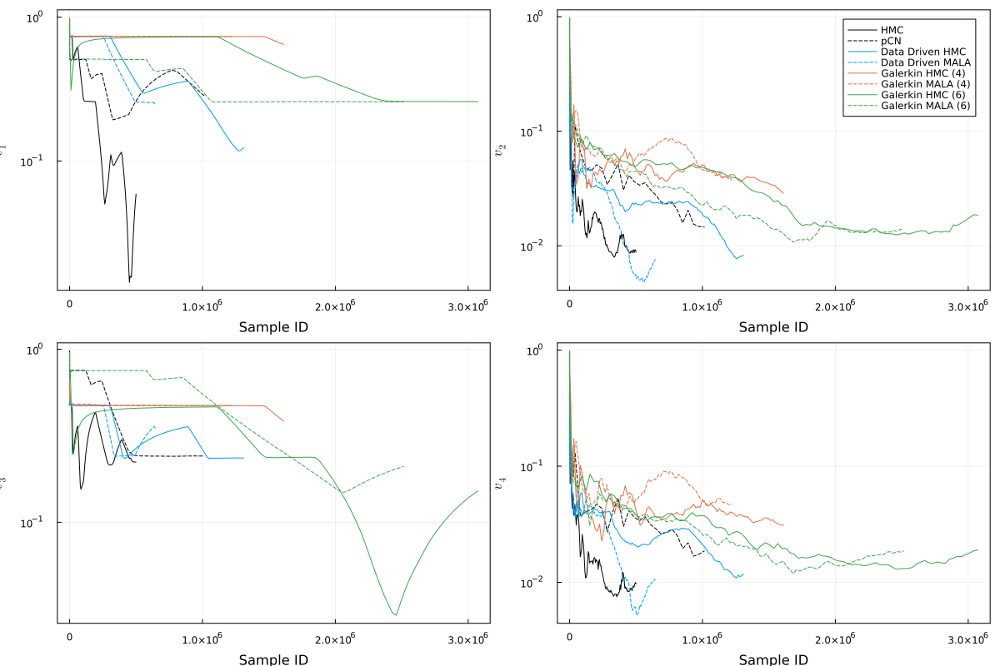

In [23]:
compList=1:4 #hopefully this matches input files
p1 = plot(size=(1200,800), layout=(length(compList)));
p2 = plot(size=(1200,800), layout=(length(compList)));

#loop over files
for i = 1:length(files)
    file   = files[i];
    label  = labels[i];
    baselinefile   = baselinefiles[i];
    
    sampFactor = sampFactors[i];
    tv         = tvs[i];
    idxList    = idxLists[i];
    
    #plot
    for j=1:length(compList)
        comp=compList[j]; #component to look at
        plot!(p1[j],idxList,tv[:,j],ls=linestyles[i],color=linecolors[i], lab=label);
        plot!(p2[j],idxList.*sampFactor,tv[:,j],ls=linestyles[i],color=linecolors[i], lab=label);
    end 
end

#label, etc
for j=1:length(compList)
    comp=compList[j];
    plot!(p1[j],xlab = "Sample ID", ylab = "\$v_$comp\$",framestyle=:box,xscale=:log10,yscale=:log10,leg=:none);#bottomleft);#,xlim=:none,ylim=(1e-2,1));
    #plot!(p1[j],tickfontsize=16,legendfontsize=16,guidefontsize=18); #professional options for when figure size is larger
    plot!(p2[j],xlab = "Sample ID", ylab = "\$v_$comp\$",framestyle=:box,xscale=:log10,yscale=:log10,leg=:none);#bottomleft);#,xlim=:none,ylim=(1e-2,1));
    #plot!(p2[j],tickfontsize=16,legendfontsize=16,guidefontsize=18); #professional options for when figure size is larger
end
plot!(p1[3],leg=:bottomleft);
plot!(p2[3],leg=:bottomleft);

display(p1)
savefig(p1,"tv_compare_by_sample.png"); savefig(p1,"tv_compare_by_sample.pdf");
display(p2)
savefig(p2,"tv_compare_by_comptime.png"); savefig(p2,"tv_compare_by_comptime.pdf");

for i=1:length(p1)
    plot!(p1[i],xscale=:none,leg=:none);
    plot!(p2[i],xscale=:none,leg=:none);
end
plot!(p1[2],leg=:topright);
plot!(p2[2],leg=:topright);
display(p1)
savefig(p1,"tv_compare_by_sample_linear.png"); savefig(p1,"tv_compare_by_sample_linear.pdf");
display(p2)
savefig(p2,"tv_compare_by_comptime_linear.png"); savefig(p2,"tv_compare_by_comptime_linear.pdf");

## Autocorrelation ##

In [17]:
function getLLH(file)
    #read log-likelihood
    f = h5open(file);
    #directly if stored directly (new file)
    #if any(x->x=="lpdfs", names(f))
    if haskey(f,"lpdfs")
        #llh = h5read(file,"lpdfs")[:,2];
        close(f);
        samples, _, lpdfs, ar, files = assembleChain(file;verbose=false,sampleThin=1,sampleCols=1:8,obsCols=1:2);
        llh = lpdfs[:,2];
    
    #construct if not (legacy file)
    else
        canPots = read(f,"canPots");
        ar = read(f,"ar");
        ar = ( ar .== 1 );
        close(f);
        
        llh = zeros(size(canPots));
        pot = canPots[1]; 
        for j=1:length(canPots); 
            ( ar[j] ) && ( pot = canPots[j] ); 
            llh[j] = -pot; 
        end 
    end

    return llh;
end
# llhs = [ getLLH(file) for file in files ];
# lags=0:500;
# llhACs = [ autocor(llh, lags) for llh in llhs ];

getLLH (generic function with 1 method)

In [18]:
lags=0:500;
try
    global llhs = h5ReadArrayOfArrays(plotDataFile,"llhs");
    global llhACs = h5ReadArrayOfArrays(plotDataFile,"llhACs");
catch e
    println("Failed to read from $(plotDataFile). Calculating from scratch...");
    global llhs = [ getLLH(file) for file in files ];
    global llhACs = [ autocor(llh, lags) for llh in llhs ];
    println("Writing values to $(plotDataFile)...");
    h5WriteArrayOfArrays(plotDataFile,"llhs",llhs);
    h5WriteArrayOfArrays(plotDataFile,"llhACs",llhACs);
end;

Failed to read from plotData_15M_simple.h5. Calculating from scratch...
Writing values to plotData_15M_simple.h5...


In [20]:
llhACs = [ autocor(llh[length(llh)÷2:end], lags) for llh in llhs ];

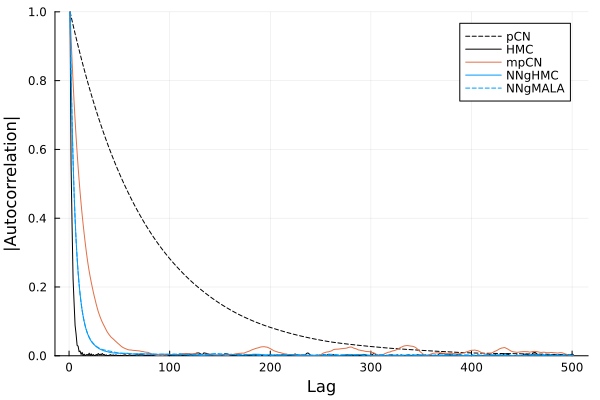

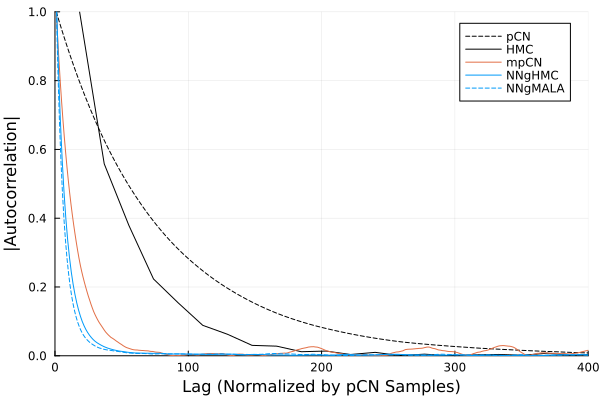

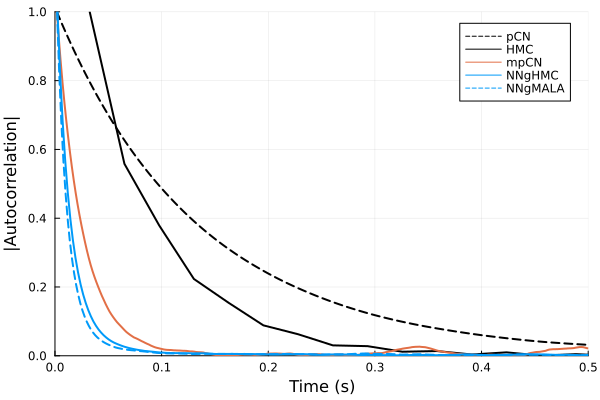

In [21]:
gr();
p1 = plot(size=(600,400), ylim=(0,1), xlab = "Lag", ylab = "|Autocorrelation|");
p2 = plot(size=(600,400), ylim=(0,1), xlab = "Lag (Normalized by pCN Samples)", 
    ylab = "|Autocorrelation|",xlim=(0,2*lags[end]));
p3 = plot(size=(600,400), ylim=(0,1), xlab = "Time (s)", ylab = "|Autocorrelation|");

pcnSampPerSec = h5read(baselinefiles[2],"sampPerSec");

#order by decreasing AC after 0.1 seconds
baseSampPerSecs = [ h5read(file,"sampPerSec") for file in baselinefiles ];
ac010=[ llhACs[i][round(Int,0.1*baseSampPerSecs[i])] for i=1:length(files) ];
idx = sortperm(ac010,rev=true);

#loop over files
for j = 1:length(files)
    i = idx[j];
#     file   = files[i];
    label  = labels[i];
    #baselinefile   = baselinefiles[i];
    llhAC = llhACs[i];
    
    sampPerSec = baseSampPerSecs[i]; #h5read(baselinefile,"sampPerSec");
    sampFactor = pcnSampPerSec / sampPerSec;
        
    plot!(p1,1:length(llhAC),abs.(llhAC),ls=linestyles[i],color=linecolors[i],lab=label);
    plot!(p2,(1:length(llhAC)).*sampFactor,abs.(llhAC),ls=linestyles[i],color=linecolors[i],lab=label);
    
    plot!(p3,(1:length(llhAC))./sampPerSec,abs.(llhAC),ls=linestyles[i],color=linecolors[i],lw=2,lab=label);

    #plot!(p1,xlim=(0,400));
    plot!(p2,xlim=(0,400));
    plot!(p3,xlim=(0,0.5));
end
display(p1)
savefig(p1,"$(plotDir)/ac_compare_by_sample.png");
savefig(p1,"$(plotDir)/ac_compare_by_sample.pdf");
display(p2)
savefig(p2,"$(plotDir)/ac_compare_by_comptime.png");
savefig(p2,"$(plotDir)/ac_compare_by_comptime.pdf");
display(p3)
savefig(p3,"$(plotDir)/ac_compare_by_seconds.png");
savefig(p3,"$(plotDir)/ac_compare_by_seconds.pdf");

# Mean Jumping Distance

In [22]:
# try
#     meanJumpDist = h5ReadArrayOfArrays(plotDataFile,"meanJumpDist");
# catch e
#     println("Failed to read from $(plotDataFile). Calculating from scratch...");
#     llhs = [ getLLH(file) for file in files ];
#     lags=0:500;
#     llhACs = [ autocor(llh, lags) for llh in llhs ];
#     println("Writing values to $(plotDataFile)...");
#     h5WriteArrayOfArrays(plotDataFile,"meanJumpDist",meanJumpDist);
# end;

In [23]:
nsamp = 10000;
meanJumpDist = zeros(length(files));

for i=1:length(files)
    file = files[i];
    
    sampToRead = nsamp; #round(Int,nsamp / sampFactors[i]);
    
    #read
    f = h5open(file);
    sampInFile = size(f["samples"],1);
    if sampToRead > sampInFile
        println("Warning: Wanted to read $(sampToRead) samples from $(file) but file only contains $(sampInFile) samples.");
        println("Reading $(sampInFile) samples instead.");
        println("Consider either reducing nsamp or backtracking to restartfiles to get more samples.");
        sampToRead = sampInFile;
    end
    samples = f["samples"][end-sampToRead+1:end,:]; #get samples from end
    #samples = f["samples"][1:sampToRead,:]; #get samples from beginning
    close(f);
    
    meanJumpDist[i] = mean(sum((samples[2:end,:]-samples[1:end-1,:]).^2,dims=2));
    
    @printf("%s: MSJD = %f (%d samples)\n",labels[i],meanJumpDist[i],size(samples,1));
end

HMC: MSJD = 1.700645 (10000 samples)
pCN: MSJD = 0.010655 (10000 samples)
NNgHMC: MSJD = 0.187817 (10000 samples)
NNgMALA: MSJD = 0.186723 (10000 samples)
mpCN: MSJD = 0.114429 (10000 samples)


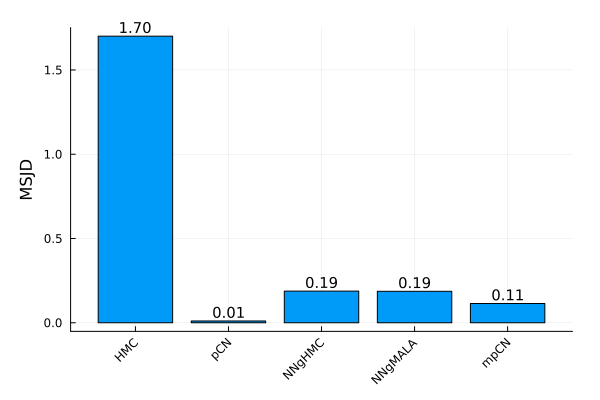

In [24]:
p = bar(labels,meanJumpDist,xrotation=45,legend=false,ylab="MSJD",margin=5mm)
#annotate!(labels,meanJumpDist,[ @sprintf("%.2f",x) for x in meanJumpDist],:bottom)
annotate!(labels,meanJumpDist,[ (@sprintf("%.2f",x),10,:bottom) for x in meanJumpDist])
display(p)
savefig(p,"$(plotDir)/msjd_compare_by_sample.png");
savefig(p,"$(plotDir)/msjd_compare_by_sample.pdf");

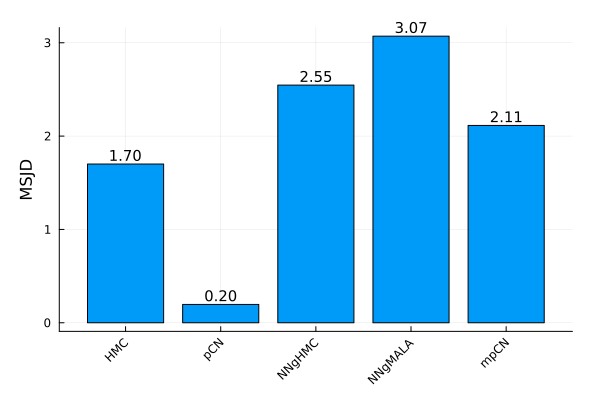

In [25]:
sampFactors = [ baselineSampPerSec / h5read(baselinefile,"sampPerSec") for baselinefile in baselinefiles ];
p = bar(labels,meanJumpDist./sampFactors,xrotation=45,legend=false,ylab="MSJD",margin=5mm)
#annotate!(labels,meanJumpDist./sampFactors,[ @sprintf("%.2f",x) for x in meanJumpDist./sampFactors],:bottom)
annotate!(labels,meanJumpDist./sampFactors,[ (@sprintf("%.2f",x),10,:bottom) for x in meanJumpDist./sampFactors])
display(p)
savefig(p,"$(plotDir)/msjd_compare_by_comptime.png");
savefig(p,"$(plotDir)/msjd_compare_by_comptime.pdf");

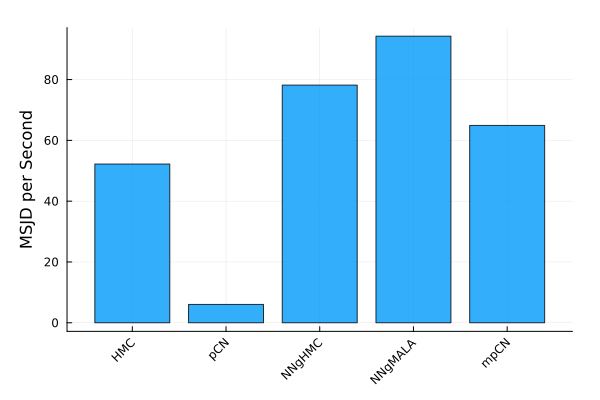

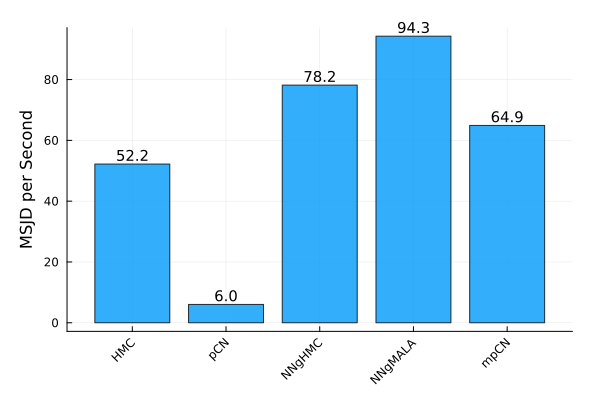

In [26]:
sampFactors = [ 1 / h5read(baselinefile,"sampPerSec") for baselinefile in baselinefiles ];
p = bar(labels,meanJumpDist./sampFactors,xrotation=45,legend=false,ylab="MSJD per Second",margin=5mm,alpha=0.8)
#annotate!(labels,meanJumpDist./sampFactors,[ @sprintf("%.2f",x) for x in meanJumpDist./sampFactors],:bottom)
display(p)
savefig(p,"$(plotDir)/msjd_compare_by_seconds_no_annotate.png");
savefig(p,"$(plotDir)/msjd_compare_by_seconds_no_annotate.pdf");
annotate!(labels,meanJumpDist./sampFactors,[ (@sprintf("%.1f",x),10,:bottom) for x in meanJumpDist./sampFactors])
display(p)
savefig(p,"$(plotDir)/msjd_compare_by_seconds.png");
savefig(p,"$(plotDir)/msjd_compare_by_seconds.pdf");

In [28]:
[ labels (1 ./ sampFactors)]

9×2 Matrix{Any}:
 "HMC"                30.7026
 "pCN"               567.375
 "NNgHMC (Small)"    416.249
 "NNgMALA (Small)"   504.923
 "NNgHMC (Medium)"   378.652
 "NNgMALA (Medium)"  504.923
 "NNgHMC (Large)"    355.763
 "NNgMALA (Large)"   456.574
 "mpCN"              567.375

## Jumps ##

In [29]:
function rollingAvg(arr,smooth)
    arrsm = zeros(Int64,length(arr));
    for i=1:length(arrsm)
        arrsm[i] = round(Int,mean(arr[maximum([1,i-smooth]):i]));
    end
    return arrsm;
end        

#find (v1,v3) jumps in a given sample file
function getJumps13(file::String;burn=0.01,thin=0.0001,smooth=50)
    #read log-likelihood
    f = h5open(file);
    #read from all files if new file
    if any(x->x=="lpdfs", names(f))
        #llh = h5read(file,"lpdfs")[:,2];
        close(f);
        samples, _, lpdfs, ar, files = assembleChain(file;verbose=false,sampleThin=thin,sampleCols=1:3,obsCols=1:2);
    
    #read if not (legacy file)
    else
#         samples = read(f,"samples");
        nsamp = nsamps[i];#read(f,"nsamp");
        sampleThin = round(Int,thin*nsamp);
        samples = f["samples"][1:sampleThin:nsamp,2:4];
        close(f);
    end
    
    #remove burnin (can be misleading)
    nburn = round(Int,size(samples,1)*burn);
    samples = samples[nburn+1:end,:];
    
    return getJumps13(samples;smooth=smooth);
end

function getJumps13(samples::Array{Float64,2};smooth=100,minspace=smooth)
    nsamp = size(samples,1);

    #angle
    angle13 = (180/pi)*atan.(samples[:,1],samples[:,3]);

    #"base"
    base13 = round.(Int,angle13 / 90) .+ 1; 
    base13[base13 .== -1] .= 3;
    
    #smooth to remove spurious jumps
    base13 = rollingAvg(base13,smooth);

    #jumps (sample ids where base changes)
    jumps13 = []; 
    for i=2:length(base13)
        if (length(jumps13) == 0) || (i-jumps13[end] >= minspace)
            ( base13[i] != base13[i-1] ) && push!(jumps13,i);
        end
    end

    return jumps13, nsamp, base13, angle13;
end

getJumps13 (generic function with 2 methods)

In [30]:
#get list of jumps for each file
thin=0.0001;
burn=0.01;
smooth=100;
minspace=smooth;

jumps13 = fill(Int64[],length(files));
# nsamps  = zeros(Int64,length(files));
sampPerJump = zeros(Float64,length(files));
sampPerJumpNrm = zeros(Float64,length(files));
secPerJump = zeros(Float64,length(files));

baselineSampPerSec = h5read(baselinefiles[1],"sampPerSec");
@printf("%20s: %16s %8s %16s %16s %16s\n","Chain","# Samples","# Jumps","Samp/Jump","Norm Samp/Jump","Sec/Jump");
for i=1:length(files);
    file = files[i];
    baselinefile   = baselinefiles[i];
    label  = labels[i];

    #get sampling factor
    sampPerSec = h5read(baselinefile,"sampPerSec");
    sampFactor = baselineSampPerSec / sampPerSec;

    #read
    f = h5open(file);
    if haskey(f,"lpdfs") #new file
        close(f);
        samples, _, _, _, _ = assembleChain(file;verbose=false,sampleThin=thin,sampleCols=1:3,obsCols=1:2);
    else #legacy
        nsamp = read(f,"nsamp");
        sampleThin = round(Int,thin*nsamp);
        samples = f["samples"][1:sampleThin:end,2:4];
        close(f);
    end
    
    #remove burnin (can be misleading)
    nburn = round(Int,size(samples,1)*burn);
    samples = samples[nburn+1:end,:];

    #get jumps
    jumps13[i], _, base13, angle13 = getJumps13(samples;smooth=smooth,minspace=minspace);
    sampPerJump[i] = nsamps[i]/length(jumps13[i]);
    sampPerJumpNrm[i] = sampPerJump[i]*sampFactor;
    secPerJump[i] = sampPerJump[i]/sampPerSec;
#     @printf("%15s: %16d %8d %16.4f\n",label,nsamps[i],length(jumps13[i]),sampPerJump[i]);
    @printf("%20s: %16d %8d %16.4f %16.4f %16.4f\n",label,nsamps[i],length(jumps13[i]),sampPerJump[i],sampPerJumpNrm[i],secPerJump[i]);
    
    #make plots
    gr(); 
    p = plot(layout=(4),xlab="sample",legend=false); 
    plot!(p[1],samples[:,1],ylab="v1"); 
    plot!(p[2],samples[:,3],ylab="v3"); 
    plot!(p[3],angle13,ylab="angle13"); 
    plot!(p[4],base13,ylab="base13");
    for k=1:2, j in jumps13[i]
        plot!(p[k],[j;j],[-2.5;2.5],color=2,ls=:dash); 
    end
    savefig("jumps/"*replace(label," "=>"_")*".png");
end

               Chain:        # Samples  # Jumps        Samp/Jump   Norm Samp/Jump         Sec/Jump
                 HMC:           500000        7       71428.5714       71428.5714        2326.4632
                 pCN:         20000000        5     4000000.0000      216453.9574        7050.0102
      NNgHMC (Small):         10000000       12      833333.3333       61466.9187        2002.0073
     NNgMALA (Small):         10000000        7     1428571.4286       86866.5117        2829.2844
     NNgHMC (Medium):         10000000       12      833333.3333       67570.1333        2200.7920
    NNgMALA (Medium):         10000000       11      909090.9091       55278.6893        1800.4537
      NNgHMC (Large):         10000000        4     2500000.0000      215752.0758        7027.1496
     NNgMALA (Large):         10000000        6     1666666.6667      112076.1025        3650.3729
                mpCN:           250000        1      250000.0000       13528.3723         440.6256


In [31]:
try
    h5WriteArrayOfArrays(plotDataFile,"jumps13",jumps13);
catch e
    println("Dataset already appears to exist in $(plotDataFile). Skipping write.");
end

## Observables ##

In [35]:
ADR_ROOT="/projects/SIAllocation";
ENV["ADR_ROOT"] = ADR_ROOT;
include("setup.jl");

Reading problem setup from datafile: /projects/SIAllocation/data/point_twohump_012.h5
datafile maxnorm > kdisc.maxnorm (32 < 8). Truncating th0 to match...


┌ Info: The GPU function is being called but the GPU is not accessible. 
└ Defaulting back to the CPU. (No action is required if you want to run on the CPU).


Setting sampler to LOL-HMC (step size=0.125, integration time=0.25)
scaling kraichnan prior so that radial integral matches chen1998simulations figure 6/7


In [36]:
kn2 = kdiscV.k[sampInd,1].^2 + kdiscV.k[sampInd,2].^2;

function getEnstrophy(file)
    #read
    f = h5open(file);
    if haskey(f,"lpdfs") #new file
        close(f);
        samples, _, _, _, _ = assembleChain(file;verbose=false,sampleThin=thin,obsCols=1:2);
    else #legacy
        nsamp = read(f,"nsamp");
        sampleThin = round(Int,thin*nsamp);
        samples = f["samples"][1:sampleThin:end,2:end];
        samples[:,1:2:end] .*=  sqrt(2);
        samples[:,2:2:end] .*= -sqrt(2);
        close(f);
    end
    
    #remove burnin (can be misleading)
    nburn = round(Int,size(samples,1)*burn);
    samples = samples[nburn+1:end,:];
    
    #enstrophy
#     enstr = [ AdvectionDiffusion.vfEnstrophy(kdiscV.k[sampInd,:],samples[i,:]) for i=1:size(samples,1) ];
    enstr = 2*pi^2*abs2.(samples)*kn2;
    
    #rolling mean
    enstr = cumsum(enstr) ./ (1:length(enstr));
#     cumsum!(enstr);
#     enstr ./= (1:length(enstr));
    
    println("Done with $(file).");
    
    return enstr;
end

getEnstrophy (generic function with 1 method)

In [37]:
try
    global enstrs = h5ReadArrayOfArrays(plotDataFile,"enstrs");
    global sampFactors = h5read(plotDataFile,"sampFactors");
    global enstrTrue = h5read(plotDataFile,"enstrTrue");
catch e
    println("Failed to read from $(plotDataFile). Calculating from scratch...");
    #get enstrophy for each file
    thin=0.0001;
    burn=0.0;

    baselineSampPerSec = h5read(baselinefiles[1],"sampPerSec");
    global enstrs = [ getEnstrophy(file) for file in files ];
    global sampFactors = [ baselineSampPerSec / h5read(baselinefile,"sampPerSec") for baselinefile in baselinefiles ];
    
    # enstrTrue = [ AdvectionDiffusion.vfEnstrophy(kdiscV.k[sampInd,:],samplesTrue[i,:]) for i=1:size(samplesTrue,1) ];
    # se = samplesTrue ];
    enstrTrue = 2*pi^2*abs2.(samplesTrue)*kn2;
    global enstrTrue = mean( enstrTrue );
    
    println("Writing values to $(plotDataFile)...");
    h5WriteArrayOfArrays(plotDataFile,"enstrs",enstrs);
    h5write(plotDataFile,"sampFactors",sampFactors);
    h5write(plotDataFile,"enstrTrue",enstrTrue);
end;

Failed to read from plotData_15M_8lines_new.h5. Calculating from scratch...
Done with /projects/SIAllocation/2020juqex2/2020juqex2_050.h5.
Done with /projects/SIAllocation/runs/173291/adr_bayes.h5.
Done with /projects/SIAllocation/lolmcNN/lolmcNN_053.h5.
Done with /projects/SIAllocation/lolmcNN/lolmcNN_054.h5.
Done with /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5.
Done with /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051.h5.
Done with /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050.h5.
Done with /projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052.h5.
Writing values to plotData_15M_8lines_new.h5...


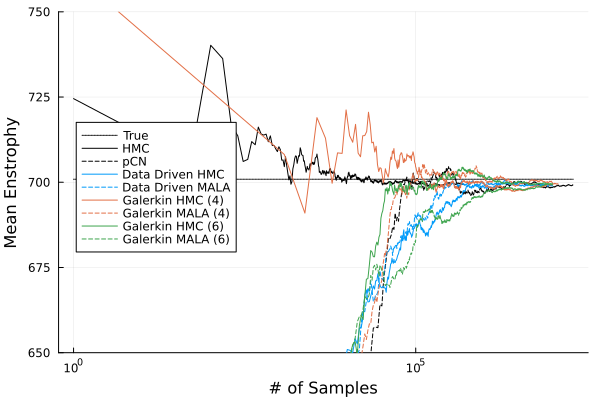

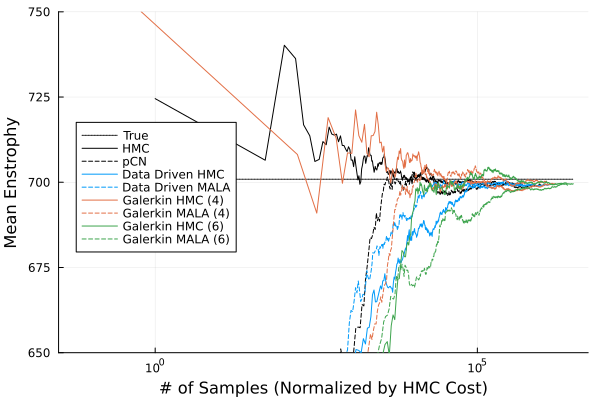

In [38]:
gr(); 
p1 = plot(size=(600,400), xlab = "# of Samples", ylab = "Mean Enstrophy",leg=:left);
p2 = plot(size=(600,400), xlab = "# of Samples (Normalized by HMC Cost)", ylab = "Mean Enstrophy",leg=:left);
plot!(p1,[1; maximum(nsamps)],[enstrTrue; enstrTrue], ls=:dot, lc=:black, lab="True");
plot!(p2,[1; maximum(nsamps.*sampFactors)],[enstrTrue; enstrTrue], ls=:dot, lc=:black, lab="True");
for i=1:length(files)
    pltx = range(1,stop=nsamps[i],length=length(enstrs[i]));#1:thin:nsamps[i];
    plty = copy(enstrs[i]);
    if i == 2 #fix tail of long pcn run
        plty = plty[pltx .<= 20000000];
        pltx = pltx[pltx .<= 20000000];
    end
    plot!(p1,pltx,plty,lab=labels[i],ls=linestyles[i],color=linecolors[i]); 
    plot!(p2,pltx.*sampFactors[i],plty,lab=labels[i],ls=linestyles[i],color=linecolors[i]); 
end
plot!(p1,xscale=:log10);
plot!(p2,xscale=:log10);
plot!(p1,ylim=(650,750));
plot!(p2,ylim=(650,750));
savefig(p1,"enstrophy_sample.png");
savefig(p1,"enstrophy_sample.pdf");
savefig(p2,"enstrophy_comptime.png");
savefig(p2,"enstrophy_comptime.pdf");
display(p1)
display(p2)

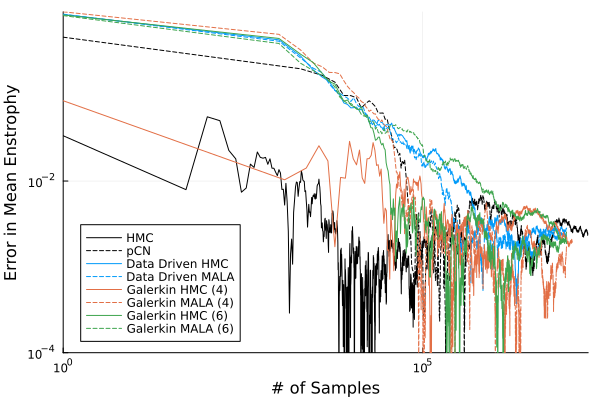

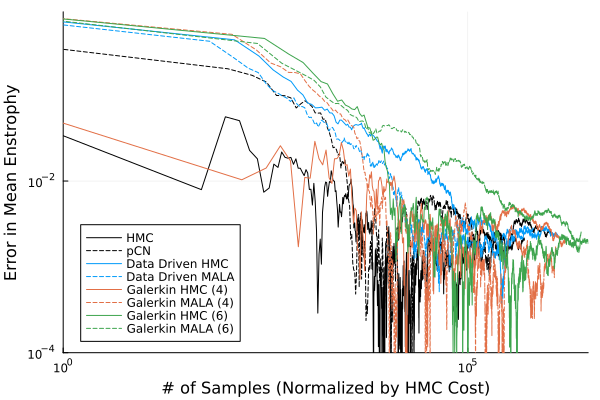

In [39]:
gr(); 
p1 = plot(size=(600,400), xlab = "# of Samples", ylab = "Error in Mean Enstrophy",leg=:topright);
p2 = plot(size=(600,400), xlab = "# of Samples (Normalized by HMC Cost)", ylab = "Error in Mean Enstrophy",leg=:topright);
# plot!(p1,[1; maximum(nsamps)],[enstrTrue; enstrTrue], ls=:dot, lc=:black, lab="True");
# plot!(p2,[1; maximum(nsamps.*sampFactors)],[enstrTrue; enstrTrue], ls=:dot, lc=:black, lab="True");
for i=1:length(files)
    pltx = range(1,stop=nsamps[i],length=length(enstrs[i]));#1:thin:nsamps[i];
    plty = abs.( (enstrs[i] .- enstrTrue) ./ enstrTrue );
    if i == 2 #fix tail of long pcn run
        plty = plty[pltx .<= 20000000];
        pltx = pltx[pltx .<= 20000000];
    end
    plot!(p1,pltx,plty,lab=labels[i],ls=linestyles[i],color=linecolors[i]); 
    plot!(p2,pltx.*sampFactors[i],plty,lab=labels[i],ls=linestyles[i],color=linecolors[i]); 
end
plot!(p1,xscale=:log10,xlim=(1,Inf));
plot!(p2,xscale=:log10,xlim=(1,Inf));
plot!(p1,ylim=(0,0.1),leg=:bottomleft);
plot!(p2,ylim=(0,0.1),leg=:bottomleft);
plot!(p1,yscale=:log10,ylim=(1e-4,Inf),leg=:bottomleft);
plot!(p2,yscale=:log10,ylim=(1e-4,Inf),leg=:bottomleft);
savefig(p1,"enstrophy_error_sample.png");
savefig(p1,"enstrophy_error_sample.pdf");
savefig(p2,"enstrophy_error_comptime.png");
savefig(p2,"enstrophy_error_comptime.pdf");
display(p1)
display(p2)

# Histogram Comparison #

In [29]:
try
    global midpts = h5read(plotDataFile,"midpts");
    global histwts = h5read(plotDataFile,"histwts");
catch e
    println("Failed to read from $(plotDataFile). Calculating from scratch...");
    
    thin=0.00001;
    burn=0.0;
    bins=-3:0.1:3;
    midpts = 0.5*( bins[2:end] + bins[1:end-1] );
    histwts = zeros(length(files)+1,length(midpts),4);

    #compute the truth
    for j=1:4
        h = fit(Histogram, samplesTrue[:,j], bins);
        h = normalize(h, mode=:pdf);
        histwts[1,:,j] = h.weights;
    end

    for i=1:length(files)
        file = files[i];

        #read
        f = h5open(file);
        if haskey(f,"lpdfs") #new file
            close(f);
            samples, _, _, _, _ = assembleChain(file;verbose=false,sampleThin=thin,sampleCols=1:4,obsCols=1:2);
        else #legacy
            nsamp = read(f,"nsamp");
            sampleThin = round(Int,thin*nsamp);
            samples = f["samples"][1:sampleThin:end,2:5];
            #convert to new format
            samples[:,1:2:end] .*=  sqrt(2);
            samples[:,2:2:end] .*= -sqrt(2);
            close(f);
        end

        #remove burnin (can be misleading)
        nburn = round(Int,size(samples,1)*burn);
        samples = samples[nburn+1:end,:];

        @printf("%s: Using %d samples\n",file,size(samples,1));

        for j=1:4
            h = fit(Histogram, samples[:,j], bins);
            h = normalize(h, mode=:pdf);
            histwts[i+1,:,j] = h.weights;
        end
    end
    
    println("Writing values to $(plotDataFile)...");
    h5write(plotDataFile,"midpts",collect(midpts));
    h5write(plotDataFile,"histwts",histwts);
    global midpts = midpts;
    global histwts = histwts;
end;

Failed to read from plotData_15M_nn_compare.h5. Calculating from scratch...
/projects/SIAllocation/2020juqex2/2020juqex2_050.h5: Using 100000 samples
/projects/SIAllocation/runs/173291/adr_bayes.h5: Using 100000 samples
/projects/SIAllocation/lolmcNN/lolmcNN_059.h5: Using 100000 samples
/projects/SIAllocation/lolmcNN/lolmcNN_054.h5: Using 100000 samples
/projects/SIAllocation/lolmcNN/lolmcNN_064.h5: Using 100000 samples
/projects/SIAllocation/lolmcNN/lolmcNN_065.h5: Using 100000 samples
/projects/SIAllocation/lolmcNN/lolmcNN_066.h5: Using 100000 samples
/projects/SIAllocation/lolmcNN/lolmcNN_067.h5: Using 100000 samples
Writing values to plotData_15M_nn_compare.h5...


GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


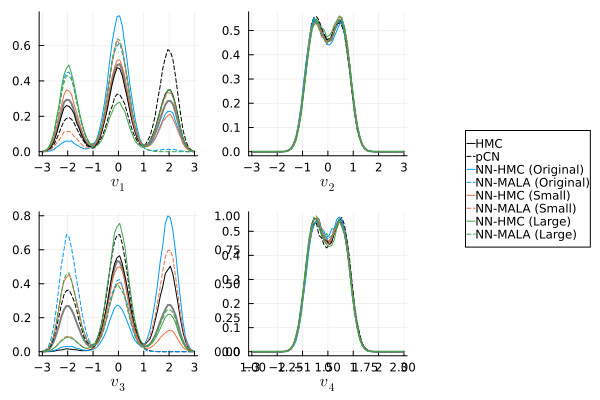

GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT
GKS: Rectangle definition is invalid in routine SET_VIEWPORT


In [30]:
gr(); 
# p = plot(layout=(4),legend=:none);
p = plot(layout = @layout([[A B; C D] E{0.25w}]),legend=:none);

#plot the truth
for j=1:4
    plot!(p[j],midpts,histwts[1,:,j],xlab="\$v_$(j)\$",lab="Truth",lc=:gray,lw=2);
end

for i=1:length(files);
    for j=1:4
        plot!(p[j],midpts,histwts[i+1,:,j],lab=labels[i],ls=linestyles[i],color=linecolors[i]);
    end
end


#add legend in "5th" plot
plot!(p[end],zeros(1,length(files)), showaxis = false, grid = false, 
    ls = reshape(linestyles,1,length(linestyles)), 
    color = reshape(linecolors,1,length(linecolors)), 
    label = reshape(labels,1,length(labels)),
    leg = :outerleft);

savefig("hist1d_compare.png");
savefig("hist1d_compare.pdf");
display(p)

# Distance Between Mean and Truth

In [42]:
#mean(samplesTrue,dims=1)[:]

In [43]:
thin = 0.00001;
burn = 0.5;
meanTrue = mean(samplesTrue,dims=1)[:];
meanL2 = zeros(length(files));

for i=1:length(files)
    file = files[i];
    
    #read
    f = h5open(file);
    if haskey(f,"lpdfs") #new file
        close(f);
        samples, _, _, _, _ = assembleChain(file;verbose=false,sampleThin=thin,obsCols=1:2);
    else #legacy
        nsamp = read(f,"nsamp");
        sampleThin = round(Int,thin*nsamp);
        samples = f["samples"][1:sampleThin:end,2:end];
        #convert to new format
        samples[:,1:2:end] .*=  sqrt(2);
        samples[:,2:2:end] .*= -sqrt(2);
        close(f);
    end
    
    #remove burnin (can be misleading)
    nburn = round(Int,size(samples,1)*burn);
    samples = samples[nburn+1:end,:];
    
    meanSamp = mean(samples,dims=1)[:];
    
    meanL2[i] = norm(meanTrue-meanSamp);
    
    @printf("%s: L2(mean-true mean) = %f (%d samples)\n",file,meanL2[i],size(samples,1));
end

/projects/SIAllocation/2020juqex2/2020juqex2_050.h5: L2(mean-true mean) = 0.823109 (50000 samples)
/projects/SIAllocation/runs/173291/adr_bayes.h5: L2(mean-true mean) = 0.707765 (50000 samples)
/projects/SIAllocation/lolmcNN/lolmcNN_053.h5: L2(mean-true mean) = 1.273977 (50000 samples)
/projects/SIAllocation/lolmcNN/lolmcNN_054.h5: L2(mean-true mean) = 2.159620 (50000 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5: L2(mean-true mean) = 1.790073 (50000 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051.h5: L2(mean-true mean) = 2.180492 (50000 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050.h5: L2(mean-true mean) = 1.480913 (50000 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052.h5: L2(mean-true mean) = 1.631396 (50000 samples)


In [44]:
nsamp = 10000;
meanTrue = mean(samplesTrue,dims=1)[:];
meanSamp = zeros(length(meanTrue),length(files));
meanL2 = zeros(length(files));

for i=1:length(files)
    file = files[i];
    
    sampToRead = round(Int,nsamp / sampFactors[i]);
    
    #read
    f = h5open(file);
    sampInFile = size(f["samples"],1);
    if sampToRead > sampInFile
        println("Warning: Wanted to read $(sampToRead) samples from $(file) but file only contains $(sampInFile) samples.");
        println("Reading $(sampInFile) samples instead.");
        println("Consider either reducing nsamp or backtracking to restartfiles to get more samples.");
        sampToRead = sampInFile;
    end
    samples = f["samples"][end-sampToRead+1:end,:]; #get samples from end
    #samples = f["samples"][1:sampToRead,:]; #get samples from beginning
    close(f);
    if size(samples,2) > length(meanTrue)
        samples = samples[:,2:end];
    end
    
    meanSamp[:,i] = mean(samples,dims=1)[:];
    
    meanL2[i] = norm(meanTrue-meanSamp[:,i]);
    
    @printf("%s: L2(mean-true mean) = %f (%d samples)\n",file,meanL2[i],size(samples,1));
end

/projects/SIAllocation/2020juqex2/2020juqex2_050.h5: L2(mean-true mean) = 2.211741 (10000 samples)
/projects/SIAllocation/runs/173291/adr_bayes.h5: L2(mean-true mean) = 1.521022 (184797 samples)
/projects/SIAllocation/lolmcNN/lolmcNN_053.h5: L2(mean-true mean) = 2.222035 (76353 samples)
/projects/SIAllocation/lolmcNN/lolmcNN_054.h5: L2(mean-true mean) = 1.815582 (155208 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_005.h5: L2(mean-true mean) = 2.389988 (74547 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_051.h5: L2(mean-true mean) = 2.239907 (82067 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_050.h5: L2(mean-true mean) = 2.337300 (32540 samples)
/projects/SIAllocation/lolmcGalerkin/lolmcGalerkin_052.h5: L2(mean-true mean) = 2.262970 (39797 samples)


In [45]:
# xidx = 1:size(meanSamp,2);
# #mcmcs = [ h5read(file,"mcmc") for file in files ];
# p = plot(size=(900,900), layout=(9),legend=:none,xticks=(xidx,labels),xrotation=45);
# for i=1:length(p)
#     scatter!(p[i],xidx,meanSamp[i,:]);
#     hline!(p[i],[meanTrue[i]]);
# end
# display(p)

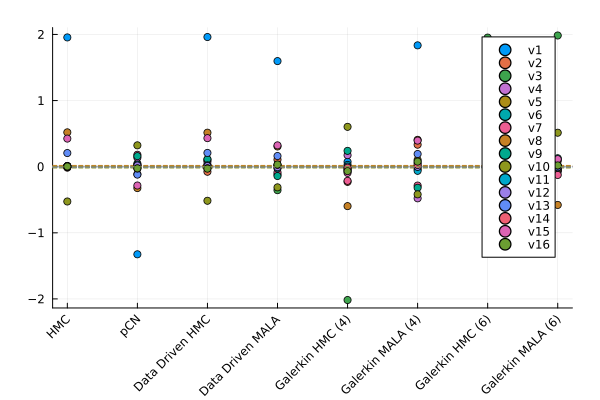

In [46]:
xidx = 1:size(meanSamp,2);
#mcmcs = [ h5read(file,"mcmc") for file in files ];
p = plot(xticks=(xidx,labels),xrotation=45,margin=5mm);
for i=1:16
    scatter!(p,xidx,meanSamp[i,:],mc=i,lab="v$(i)");
    hline!(p,[meanTrue[i]],lc=i,ls=:dash,lab=:none);
end
display(p)

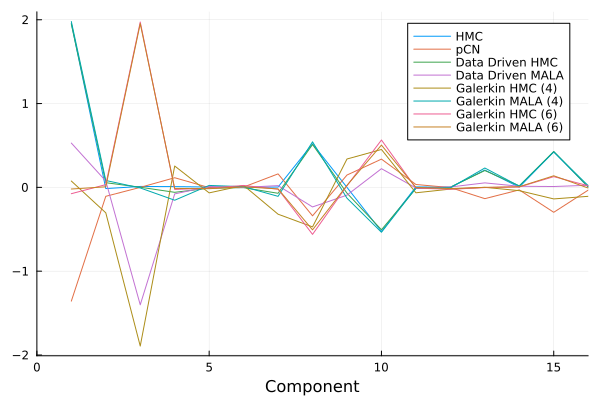

In [124]:
plot(1:size(meanSamp,1),meanSamp,lab=reshape(labels,1,length(labels)),xlab="Component",xlim=(0,16))

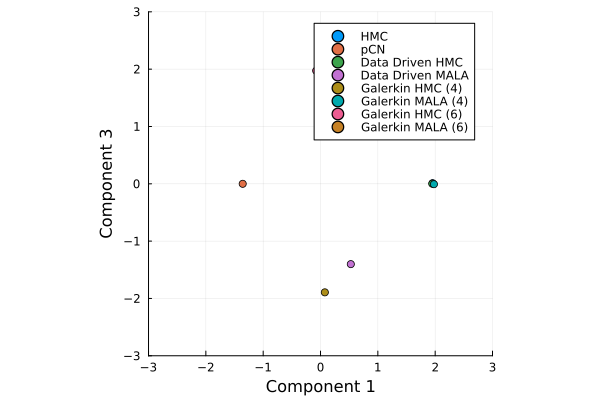

In [125]:
scatter(meanSamp[1,:]',meanSamp[3,:]',lab=reshape(labels,1,length(labels)),xlab="Component 1",ylab="Component 3",xlim=(-3,3),ylim=(-3,3),aspect_ratio=:equal)

In [126]:
idx=[1,3];
tmpNrm = zeros(length(idx));
@printf("%20s","mcmc");
for j=1:length(idx)
    @printf(" %10s","v$(idx[j])");
end
@printf(" %10s\n","norm");
for i=1:size(meanSamp,2)
    @printf("%20s",labels[i]);
    for j=1:length(idx)
        tmpNrm[j] = abs(meanTrue[idx[j]]-meanSamp[idx[j],i]);
        @printf(" %10f",tmpNrm[j]);
    end
    @printf(" %10f\n",norm(tmpNrm));
end

                mcmc         v1         v3       norm
                 HMC   1.963704   0.001919   1.963705
                 pCN   1.348727   0.012987   1.348790
     Data Driven HMC   1.957897   0.011208   1.957929
    Data Driven MALA   0.536925   1.414126   1.512628
    Galerkin HMC (4)   0.084014   1.906186   1.908036
   Galerkin MALA (4)   1.986803   0.019707   1.986900
    Galerkin HMC (6)   0.067037   1.959645   1.960792
   Galerkin MALA (6)   0.011285   1.940260   1.940293


# 2D Histograms

In [32]:
[ lowercase(replace(lab," "=>"_","("=>"",")"=>"")) for lab in labels ]

9-element Vector{String}:
 "hmc"
 "pcn"
 "nnghmc_small"
 "nngmala_small"
 "nnghmc_medium"
 "nngmala_medium"
 "nnghmc_large"
 "nngmala_large"
 "mpcn"

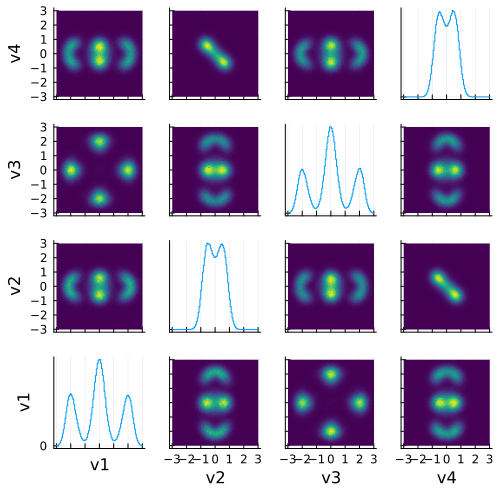

wrote: 2dhist_true.{png,pdf}


In [33]:
bins=[ range(-3,stop=3,length=100) range(-3,stop=3,length=100) ];
p = histmatrix(samplesTrue[:,1:4];bins=bins,size=(500,500),
    margin=0.0mm,xticks=-3:3,yticks=-3:3, label=["v$(i)" for i=1:4]);
display(p)
    
pltName = "2dhist_true";
savefig(p,pltName*".png");
savefig(p,pltName*".pdf");
println("wrote: $(pltName).{png,pdf}");

2020juqex2_050.h5: reading 200000 samples


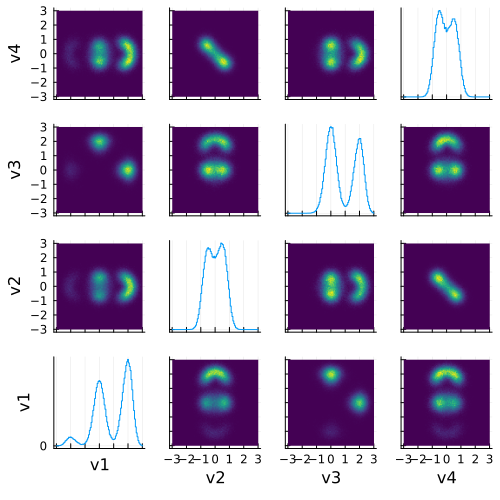

wrote: 2dhist_200000_hmc.{png,pdf}
adr_bayes.h5: reading 3695936 samples
Ignoring first column


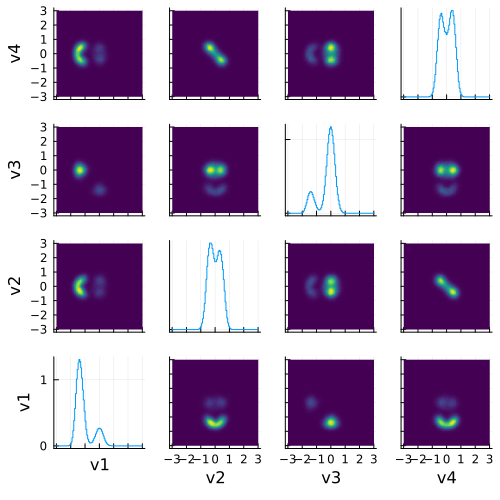

wrote: 2dhist_200000_pcn.{png,pdf}
lolmcNN_064.h5: reading 2711486 samples


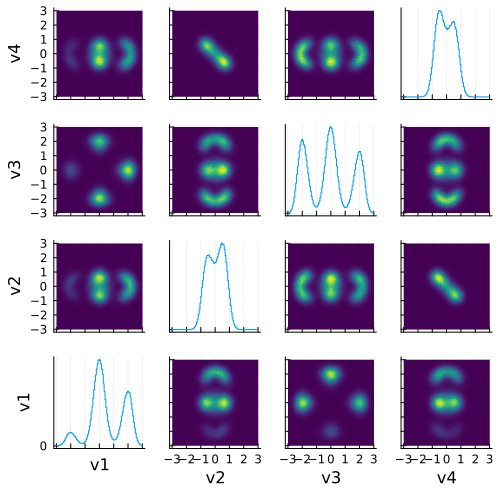

wrote: 2dhist_200000_nnghmc_small.{png,pdf}
lolmcNN_065.h5: reading 3289119 samples


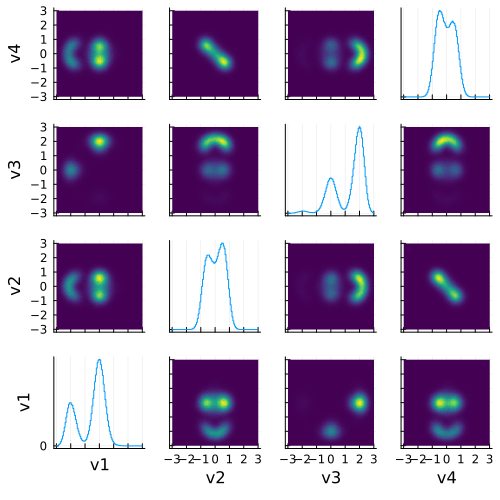

wrote: 2dhist_200000_nngmala_small.{png,pdf}
lolmcNN_069.h5: reading 2466573 samples


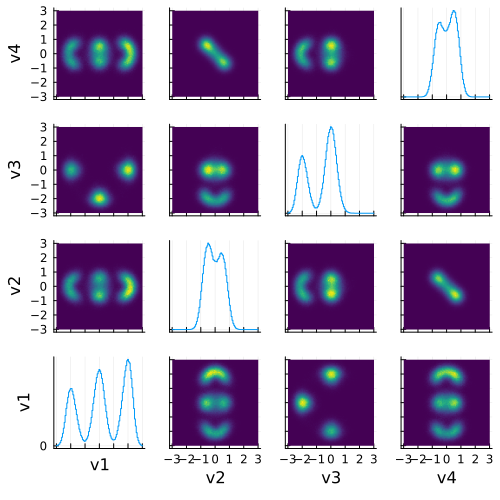

wrote: 2dhist_200000_nnghmc_medium.{png,pdf}
lolmcNN_071.h5: reading 3289119 samples


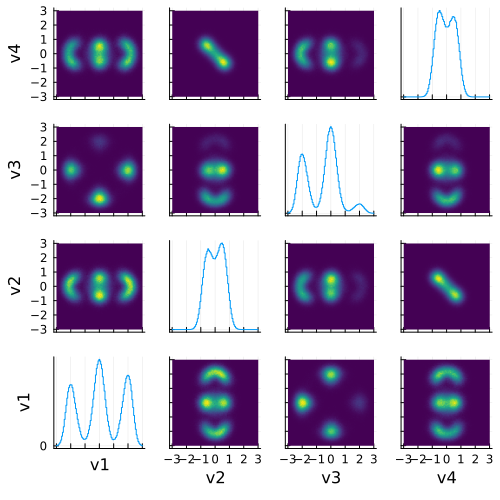

wrote: 2dhist_200000_nngmala_medium.{png,pdf}
lolmcNN_072.h5: reading 2317475 samples


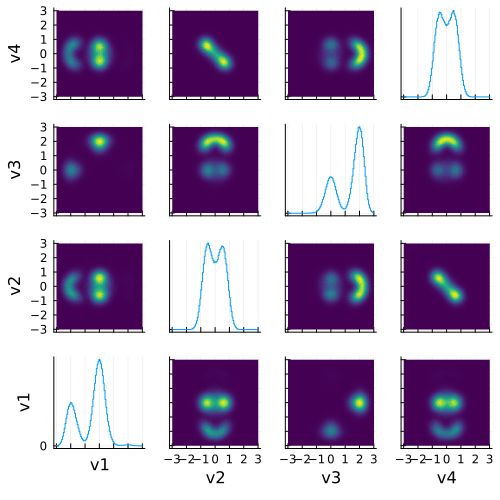

wrote: 2dhist_200000_nnghmc_large.{png,pdf}
lolmcNN_074.h5: reading 2974170 samples


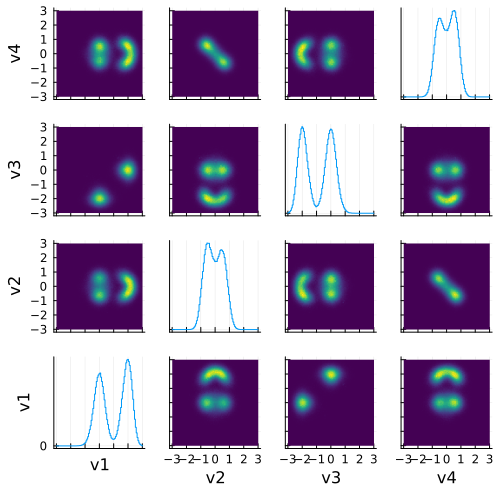

wrote: 2dhist_200000_nngmala_large.{png,pdf}
2020juqex2_099.h5: reading 3695936 samples
Reading 250000 samples instead.
Consider either reducing nsamp or backtracking to restartfiles to get more samples.


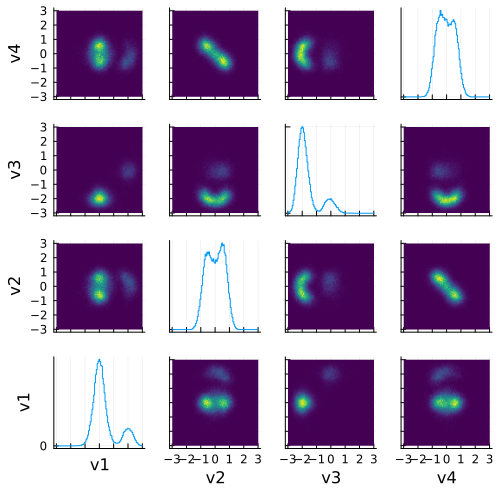

wrote: 2dhist_200000_mpcn.{png,pdf}


In [38]:
nsamp = 200000;
nthin = 1;

for i=1:length(files)
    file = files[i];
    label = labels[i];
    
    sampToRead = round(Int,nsamp / sampFactors[i]);
    println("$(basename(file)): reading $(sampToRead) samples");
    
    #read
    f = h5open(file);
    sampInFile = size(f["samples"],1);
    if sampToRead > sampInFile
        println("Warning: Wanted to read $(sampToRead) samples from $(file) but file only contains $(sampInFile) samples.");
        println("Reading $(sampInFile) samples instead.");
        println("Consider either reducing nsamp or backtracking to restartfiles to get more samples.");
        sampToRead = sampInFile;
    end
    samples = f["samples"][end-sampToRead+1:end,1:5]; #get samples from end
    #samples = f["samples"][1:sampToRead,:]; #get samples from beginning
    close(f);
    if norm(samples[:,1]) == 0.0
        println("Ignoring first column");
        samples = samples[:,2:end];
    end
    
    bins=[ range(-3,stop=3,length=100) range(-3,stop=3,length=100) ];
    p = histmatrix(samples[1:nthin:end,1:4];bins=bins,size=(500,500),
        margin=0.0mm,xticks=-3:3,yticks=-3:3, label=["v$(i)" for i=1:4]);
    display(p)
    
    pltName = replace(file,".h5"=>"_2dhist_$(sampToRead)");
    savefig(p,pltName*".png");
    savefig(p,pltName*".pdf");
    
    pltName = "2dhist_$(nsamp)_"*lowercase(replace(label," "=>"_","("=>"",")"=>""));
    savefig(p,pltName*".png");
    savefig(p,pltName*".pdf");
    println("wrote: $(pltName).{png,pdf}");
end

# Experimentation

In [106]:
samples, _, lpdfs, ar, _ = assembleChain(files[3];verbose=true,sampleCols=1:4,obsCols=1:2);

Read 10000000 samples from /projects/SIAllocation/lolmcNN/lolmcNN_053.h5
Done. 10000000 total samples read out of 10000000 found.


In [107]:
function rollingAvg(arr,smooth)
    arrsm = zeros(length(arr));
    for i=1:length(arrsm)
        arrsm[i] = mean(arr[maximum([1,i-smooth]):i]);
    end
    return arrsm;
end

rollingAvg (generic function with 1 method)

In [108]:
function reduceMean(arr,smooth)
    idx = 1:smooth:length(arr);
    arrsm = zeros(length(idx));
    for i=1:length(arrsm)
        arrsm[i] = mean(arr[idx[i]:minimum([idx[i]+smooth-1,length(arr)])]);
    end
    return arrsm;
end

reduceMean (generic function with 1 method)

In [109]:
# roll1 = rollingAvg(samples[:,1],1000);
# roll3 = rollingAvg(samples[:,3],1000);

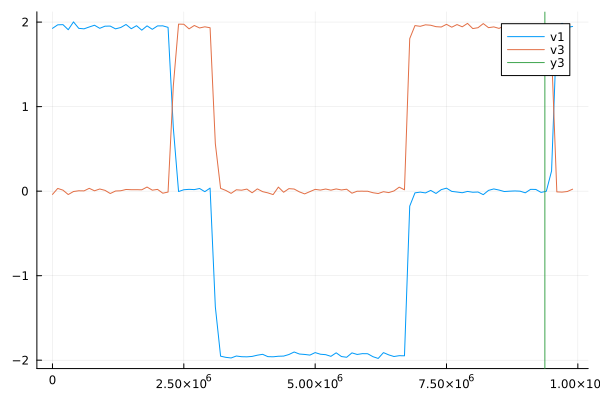

In [113]:
thin=100000;
r1 = reduceMean(samples[:,1],thin);
r3 = reduceMean(samples[:,3],thin);
plot(1:thin:size(samples,1),r1,lab="v1")
plot!(1:thin:size(samples,1),r3,lab="v3")
vline!([size(samples,1)-627665])

In [112]:
mean(samples[end-627665:end,:],dims=1)

1×4 Matrix{Float64}:
 1.28196  -0.00852463  0.654149  0.00881422

# Assemble DataFrame

In [40]:
mcmcMeths   = [ "" for i=1:length(files) ];
mcmcParams  = [ "" for i=1:length(files) ];
nsamps      = zeros(length(files));
#ars         = zeros(length(files));
sampPerSecs = zeros(length(files));

baseMcmcMeths   = [ "" for i=1:length(files) ];
baseMcmcParams  = [ "" for i=1:length(files) ];
baseNsamps      = zeros(length(files));
baseSampPerSecs = zeros(length(files));

msjds     = meanJumpDist;

In [41]:
baselineSampPerSec = h5read(baselinefiles[1],"sampPerSec");
for i=1:length(files)
    file = files[i];
    baselinefile = baselinefiles[i];
    label = labels[i];

    #ars[i]     = h5read(        file,"acceptRatio");

    try
        sampPerSecs[i]     = h5read(        file,"sampPerSec");
    catch e
        sampPerSecs[i]     = h5read(replace(file,".h5"=>"_orig.h5"),"sampPerSec");
    end
    baseSampPerSecs[i] = h5read(baselinefile,"sampPerSec");

    nsamps[i]     = h5read(        file,"sampComplete");
    baseNsamps[i] = h5read(baselinefile,"sampComplete");

    mcmc = try 
        h5read(file,"mcmc")
    catch e
        h5read(baselinefile,"mcmc")
    end
    mcmcs = split(mcmc,"|");
    mcmcmeth = uppercase(mcmcs[1]);
    
    if mcmcmeth=="HMC" || mcmcmeth=="LOLHMC" || mcmcmeth=="MPPCN"
        mcmcp = "("*mcmcs[2]*", "*mcmcs[3]*")";
    else
        mcmcp = "("*mcmcs[2]*")";
    end
    
    mcmcmeth = replace(mcmcmeth,"MPPCN"=>"mpCN","PCN"=>"pCN","LOL"=>"");
    
    mcmcMeths[i]  = mcmcmeth
    mcmcParams[i] = mcmcp
        
#     println("$(label) ($(file)): $(sampPerSec)");
    @printf("%20s | %8s | %10s | %10d | %6.1f | %8.1f \n",label,mcmcmeth,mcmcp,nsamps[i],sampPerSecs[i],baseSampPerSecs[i]);
end

                 HMC |      HMC |  (2^-2, 4) |     500000 |   25.7 |     30.7 
                 pCN |      pCN |      (0.2) |   20000000 |   47.3 |    567.4 
      NNgHMC (Small) |      HMC |  (0.25, 2) |   10000000 |  386.0 |    416.2 
     NNgMALA (Small) |     MALA |     (0.25) |   10000000 |  461.5 |    504.9 
     NNgHMC (Medium) |      HMC |  (0.25, 2) |   10000000 |  380.2 |    378.7 
    NNgMALA (Medium) |     MALA |     (0.25) |   10000000 |  361.3 |    504.9 
      NNgHMC (Large) |      HMC |  (0.25, 2) |   10000000 |  350.9 |    355.8 
     NNgMALA (Large) |     MALA |     (0.25) |   10000000 |  456.6 |    456.6 
                mpCN |     mpCN | (0.25, 64) |     250000 |    3.6 |    567.4 


In [42]:
using DataFrames, CSV

In [43]:
df = DataFrame((
        File=[ basename(file) for file in files ],
        BaseFile=[ basename(file) for file in baselinefiles ],
        Labels=labels,
        #MCMC=mcmcs,
        MCMCmethods=mcmcMeths,
        MCMCparams=mcmcParams,
        Samples=nsamps,
        SampPerSec=sampPerSecs,
        BaseSampPerSec=baseSampPerSecs,
        #Gnorm=gnorms,
        AR=ars,
        AC010=[ llhACs[i][round(Int,0.1*baseSampPerSecs[i])] for i=1:length(files) ],
        AC020=[ llhACs[i][round(Int,0.2*baseSampPerSecs[i])] for i=1:length(files) ],
        MSJD=msjds,
        MSJDtime=msjds.*baseSampPerSecs,
        Jumps=[length(jumps) for jumps in jumps13]
        ));
df

Row,File,BaseFile,Labels,MCMCmethods,MCMCparams,Samples,SampPerSec,BaseSampPerSec,AR,AC010,AC020,MSJD,MSJDtime,Jumps
,String,String,String,String,String,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64
1,2020juqex2_050.h5,2020juqex2_055.h5,HMC,HMC,"(2^-2, 4)",500000.0,25.6611,30.7026,0.96119,0.379081,-0.0885083,1.70064,52.2143,7
2,adr_bayes.h5,2020juqex2_011.h5,pCN,pCN,(0.2),2.0e7,47.2661,567.375,0.270565,0.4851,0.240612,0.0106549,6.04535,5
3,lolmcNN_064.h5,lolmcNN_070.h5,NNgHMC (Small),HMC,"(0.25, 2)",1.0e7,385.963,416.249,0.405698,0.00930523,0.00421818,0.187817,78.1786,12
4,lolmcNN_065.h5,lolmcNN_052.h5,NNgMALA (Small),MALA,(0.25),1.0e7,461.484,504.923,0.407502,0.00801185,0.00470641,0.186723,94.2808,7
5,lolmcNN_069.h5,lolmcNN_059.h5,NNgHMC (Medium),HMC,"(0.25, 2)",1.0e7,380.179,378.652,0.398982,0.0132248,0.0051042,0.186824,70.7413,12
6,lolmcNN_071.h5,lolmcNN_052.h5,NNgMALA (Medium),MALA,(0.25),1.0e7,361.313,504.923,0.398174,0.00712552,0.00416104,0.189013,95.437,11
7,lolmcNN_072.h5,lolmcNN_066.h5,NNgHMC (Large),HMC,"(0.25, 2)",1.0e7,350.939,355.763,0.404157,0.0110095,0.00814593,0.185886,66.1313,4
8,lolmcNN_074.h5,lolmcNN_074.h5,NNgMALA (Large),MALA,(0.25),1.0e7,456.574,456.574,0.4012,0.00742666,0.00548923,0.179851,82.1155,6
9,2020juqex2_099.h5,2020juqex2_011.h5,mpCN,mpCN,"(0.25, 64)",250000.0,3.60148,567.375,0.478744,0.0196181,0.00606657,0.114429,64.9239,1


In [44]:
outCols = [:Labels,:MCMCparams,:Samples,:BaseSampPerSec,:AR,:AC010,:AC020,:MSJDtime,:Jumps];
formatters = (v, i, j) -> (j == 4) ? ft_printf("%.1f",v) : v;
show(stdout, MIME("text/latex"), df[:,outCols]);#;formatters=formatters)

\begin{tabular}{r|ccccccccc}
	& Labels & MCMCparams & Samples & BaseSampPerSec & AR & AC010 & AC020 & MSJDtime & Jumps\\
	\hline
	& String & String & Float64 & Float64 & Float64 & Float64 & Float64 & Float64 & Int64\\
	\hline
	1 & HMC & (2\^-2, 4) & 500000.0 & 30.7026 & 0.96119 & 0.379081 & -0.0885083 & 52.2143 & 7 \\
	2 & pCN & (0.2) & 2.0e7 & 567.375 & 0.270565 & 0.4851 & 0.240612 & 6.04535 & 5 \\
	3 & NNgHMC (Small) & (0.25, 2) & 1.0e7 & 416.249 & 0.405698 & 0.00930523 & 0.00421818 & 78.1786 & 12 \\
	4 & NNgMALA (Small) & (0.25) & 1.0e7 & 504.923 & 0.407502 & 0.00801185 & 0.00470641 & 94.2808 & 7 \\
	5 & NNgHMC (Medium) & (0.25, 2) & 1.0e7 & 378.652 & 0.398982 & 0.0132248 & 0.0051042 & 70.7413 & 12 \\
	6 & NNgMALA (Medium) & (0.25) & 1.0e7 & 504.923 & 0.398174 & 0.00712552 & 0.00416104 & 95.437 & 11 \\
	7 & NNgHMC (Large) & (0.25, 2) & 1.0e7 & 355.763 & 0.404157 & 0.0110095 & 0.00814593 & 66.1313 & 4 \\
	8 & NNgMALA (Large) & (0.25) & 1.0e7 & 456.574 & 0.4012 & 0.00742666 & 0.005489

In [45]:
f = open("summary.tex","w");
show(f, MIME("text/latex"), df[:,outCols]);
close(f);
CSV.write("summary.csv", df[:,outCols])

"summary.csv"